# Afriat

In [1]:
scan=0.1425

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2561,3279,9403
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2561,2566,1675,3450,1670,3321
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4434,10809
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 644,830,2336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 644,636,433,840,379,878
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1150,2660
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:19:07, 13.93s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:19:07, 13.93s/it, v_num=1, total_loss_train=3.68e+3, kl_local_train=60.2]

Epoch 2/600:   0%|          | 1/600 [00:13<2:19:07, 13.93s/it, v_num=1, total_loss_train=3.68e+3, kl_local_train=60.2]

Epoch 2/600:   0%|          | 2/600 [00:26<2:13:01, 13.35s/it, v_num=1, total_loss_train=3.68e+3, kl_local_train=60.2]

Epoch 2/600:   0%|          | 2/600 [00:26<2:13:01, 13.35s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.4]

Epoch 3/600:   0%|          | 2/600 [00:26<2:13:01, 13.35s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.4]

Epoch 3/600:   0%|          | 3/600 [00:39<2:10:32, 13.12s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=90.4]

Epoch 3/600:   0%|          | 3/600 [00:39<2:10:32, 13.12s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.3] 

Epoch 4/600:   0%|          | 3/600 [00:39<2:10:32, 13.12s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.3]

Epoch 4/600:   1%|          | 4/600 [00:52<2:08:23, 12.93s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.3]

Epoch 4/600:   1%|          | 4/600 [00:52<2:08:23, 12.93s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87]  

Epoch 5/600:   1%|          | 4/600 [00:52<2:08:23, 12.93s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87]

Epoch 5/600:   1%|          | 5/600 [01:05<2:08:40, 12.98s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87]

Epoch 5/600:   1%|          | 5/600 [01:05<2:08:40, 12.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.3]

Epoch 6/600:   1%|          | 5/600 [01:06<2:08:40, 12.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.3]

Epoch 6/600:   1%|          | 6/600 [01:19<2:10:54, 13.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=78.3]

Epoch 6/600:   1%|          | 6/600 [01:19<2:10:54, 13.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=65.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 6/600 [01:19<2:10:54, 13.22s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=65.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 7/600 [01:31<2:08:21, 12.99s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=65.9, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 7/600 [01:31<2:08:21, 12.99s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|          | 7/600 [01:31<2:08:21, 12.99s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▏         | 8/600 [01:44<2:06:19, 12.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▏         | 8/600 [01:44<2:06:19, 12.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=31.2, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 9/600:   1%|▏         | 8/600 [01:44<2:06:19, 12.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=31.2, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▏         | 9/600 [01:56<2:05:02, 12.70s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=31.2, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▏         | 9/600 [01:56<2:05:02, 12.70s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 9/600 [01:56<2:05:02, 12.70s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 10/600 [02:08<2:04:17, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 10/600 [02:09<2:04:17, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.6, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 10/600 [02:10<2:04:17, 12.64s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.6, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 11/600 [02:22<2:07:37, 13.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=24.6, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00717, metric_mi|time_cat_train=0.012, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 11/600 [02:22<2:07:37, 13.00s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33.5, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417] 

Epoch 12/600:   2%|▏         | 11/600 [02:22<2:07:37, 13.00s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33.5, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 12/600:   2%|▏         | 12/600 [02:35<2:05:31, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33.5, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 12/600:   2%|▏         | 12/600 [02:35<2:05:31, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=41.3, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 13/600:   2%|▏         | 12/600 [02:35<2:05:31, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=41.3, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 13/600:   2%|▏         | 13/600 [02:47<2:03:30, 12.62s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=41.3, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 13/600:   2%|▏         | 13/600 [02:47<2:03:30, 12.62s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=47.8, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 14/600:   2%|▏         | 13/600 [02:47<2:03:30, 12.62s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=47.8, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 14/600:   2%|▏         | 14/600 [02:59<2:02:38, 12.56s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=47.8, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 14/600:   2%|▏         | 14/600 [02:59<2:02:38, 12.56s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=53.4, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 15/600:   2%|▏         | 14/600 [02:59<2:02:38, 12.56s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=53.4, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 15/600:   2%|▎         | 15/600 [03:12<2:02:09, 12.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=53.4, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 15/600:   2%|▎         | 15/600 [03:12<2:02:09, 12.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=56.6, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 16/600:   2%|▎         | 15/600 [03:13<2:02:09, 12.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=56.6, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 16/600:   3%|▎         | 16/600 [03:26<2:05:37, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=56.6, metric_mi|status_control_train=0.022, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0175, metric_mi|mouse_train=0.0417]

Epoch 16/600:   3%|▎         | 16/600 [03:26<2:05:37, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 17/600:   3%|▎         | 16/600 [03:26<2:05:37, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 17/600:   3%|▎         | 17/600 [03:38<2:03:56, 12.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 17/600:   3%|▎         | 17/600 [03:38<2:03:56, 12.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 18/600:   3%|▎         | 17/600 [03:38<2:03:56, 12.76s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 18/600:   3%|▎         | 18/600 [03:50<2:02:39, 12.65s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 18/600:   3%|▎         | 18/600 [03:50<2:02:39, 12.65s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 19/600:   3%|▎         | 18/600 [03:50<2:02:39, 12.65s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 19/600:   3%|▎         | 19/600 [04:03<2:01:36, 12.56s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 19/600:   3%|▎         | 19/600 [04:03<2:01:36, 12.56s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]  

Epoch 20/600:   3%|▎         | 19/600 [04:03<2:01:36, 12.56s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 20/600:   3%|▎         | 20/600 [04:15<2:01:08, 12.53s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=72, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 20/600:   3%|▎         | 20/600 [04:15<2:01:08, 12.53s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 21/600:   3%|▎         | 20/600 [04:17<2:01:08, 12.53s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 21/600:   4%|▎         | 21/600 [04:29<2:04:23, 12.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.059]

Epoch 21/600:   4%|▎         | 21/600 [04:29<2:04:23, 12.89s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 22/600:   4%|▎         | 21/600 [04:29<2:04:23, 12.89s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 22/600:   4%|▎         | 22/600 [04:41<2:02:47, 12.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.6, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 22/600:   4%|▎         | 22/600 [04:41<2:02:47, 12.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 23/600:   4%|▎         | 22/600 [04:41<2:02:47, 12.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 23/600:   4%|▍         | 23/600 [04:54<2:01:34, 12.64s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=91.5, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 23/600:   4%|▍         | 23/600 [04:54<2:01:34, 12.64s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=98.7, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 24/600:   4%|▍         | 23/600 [04:54<2:01:34, 12.64s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=98.7, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 24/600:   4%|▍         | 24/600 [05:06<2:00:39, 12.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=98.7, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 24/600:   4%|▍         | 24/600 [05:06<2:00:39, 12.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768] 

Epoch 25/600:   4%|▍         | 24/600 [05:06<2:00:39, 12.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 25/600:   4%|▍         | 25/600 [05:19<2:00:12, 12.54s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 25/600:   4%|▍         | 25/600 [05:19<2:00:12, 12.54s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 26/600:   4%|▍         | 25/600 [05:20<2:00:12, 12.54s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 26/600:   4%|▍         | 26/600 [05:32<2:03:01, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0705, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0768]

Epoch 26/600:   4%|▍         | 26/600 [05:32<2:03:01, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 27/600:   4%|▍         | 26/600 [05:32<2:03:01, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 27/600:   4%|▍         | 27/600 [05:45<2:01:33, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=120, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 27/600:   4%|▍         | 27/600 [05:45<2:01:33, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 28/600:   4%|▍         | 27/600 [05:45<2:01:33, 12.73s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 28/600:   5%|▍         | 28/600 [05:57<2:00:19, 12.62s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=119, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 28/600:   5%|▍         | 28/600 [05:57<2:00:19, 12.62s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 29/600:   5%|▍         | 28/600 [05:57<2:00:19, 12.62s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 29/600:   5%|▍         | 29/600 [06:09<1:59:26, 12.55s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 29/600:   5%|▍         | 29/600 [06:09<1:59:26, 12.55s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 30/600:   5%|▍         | 29/600 [06:09<1:59:26, 12.55s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 30/600:   5%|▌         | 30/600 [06:22<1:58:28, 12.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 30/600:   5%|▌         | 30/600 [06:22<1:58:28, 12.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 31/600:   5%|▌         | 30/600 [06:23<1:58:28, 12.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 31/600:   5%|▌         | 31/600 [06:35<2:00:36, 12.72s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0749, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0886, metric_mi|mouse_train=0.0996]

Epoch 31/600:   5%|▌         | 31/600 [06:35<2:00:36, 12.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]    

Epoch 32/600:   5%|▌         | 31/600 [06:35<2:00:36, 12.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 32/600:   5%|▌         | 32/600 [06:47<1:57:39, 12.43s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 32/600:   5%|▌         | 32/600 [06:47<1:57:39, 12.43s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 33/600:   5%|▌         | 32/600 [06:47<1:57:39, 12.43s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 33/600:   6%|▌         | 33/600 [06:58<1:55:25, 12.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 33/600:   6%|▌         | 33/600 [06:58<1:55:25, 12.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 33/600 [06:58<1:55:25, 12.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 34/600 [07:10<1:53:52, 12.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 34/600 [07:10<1:53:52, 12.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 34/600 [07:10<1:53:52, 12.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 35/600 [07:22<1:53:17, 12.03s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 35/600 [07:22<1:53:17, 12.03s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 35/600 [07:23<1:53:17, 12.03s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 36/600 [07:35<1:56:18, 12.37s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 36/600 [07:35<1:56:18, 12.37s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 37/600:   6%|▌         | 36/600 [07:35<1:56:18, 12.37s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 37/600:   6%|▌         | 37/600 [07:47<1:54:40, 12.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=94.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 37/600:   6%|▌         | 37/600 [07:47<1:54:40, 12.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 38/600:   6%|▌         | 37/600 [07:47<1:54:40, 12.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 38/600:   6%|▋         | 38/600 [07:59<1:53:26, 12.11s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 38/600:   6%|▋         | 38/600 [07:59<1:53:26, 12.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]  

Epoch 39/600:   6%|▋         | 38/600 [07:59<1:53:26, 12.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 39/600:   6%|▋         | 39/600 [08:11<1:52:39, 12.05s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 39/600:   6%|▋         | 39/600 [08:11<1:52:39, 12.05s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 40/600:   6%|▋         | 39/600 [08:11<1:52:39, 12.05s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 40/600:   7%|▋         | 40/600 [08:23<1:53:40, 12.18s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 40/600:   7%|▋         | 40/600 [08:23<1:53:40, 12.18s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 41/600:   7%|▋         | 40/600 [08:25<1:53:40, 12.18s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 41/600:   7%|▋         | 41/600 [08:37<1:58:26, 12.71s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.116]

Epoch 41/600:   7%|▋         | 41/600 [08:37<1:58:26, 12.71s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 42/600:   7%|▋         | 41/600 [08:37<1:58:26, 12.71s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 42/600:   7%|▋         | 42/600 [08:50<1:57:49, 12.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 42/600:   7%|▋         | 42/600 [08:50<1:57:49, 12.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 43/600:   7%|▋         | 42/600 [08:50<1:57:49, 12.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 43/600:   7%|▋         | 43/600 [09:03<1:57:30, 12.66s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 43/600:   7%|▋         | 43/600 [09:03<1:57:30, 12.66s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119] 

Epoch 44/600:   7%|▋         | 43/600 [09:03<1:57:30, 12.66s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 44/600:   7%|▋         | 44/600 [09:15<1:56:56, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 44/600:   7%|▋         | 44/600 [09:15<1:56:56, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 45/600:   7%|▋         | 44/600 [09:15<1:56:56, 12.62s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 45/600:   8%|▊         | 45/600 [09:27<1:56:05, 12.55s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 45/600:   8%|▊         | 45/600 [09:27<1:56:05, 12.55s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 46/600:   8%|▊         | 45/600 [09:29<1:56:05, 12.55s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 46/600:   8%|▊         | 46/600 [09:41<1:59:50, 12.98s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 46/600:   8%|▊         | 46/600 [09:41<1:59:50, 12.98s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 47/600:   8%|▊         | 46/600 [09:41<1:59:50, 12.98s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 47/600:   8%|▊         | 47/600 [09:54<1:58:38, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 47/600:   8%|▊         | 47/600 [09:54<1:58:38, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 48/600:   8%|▊         | 47/600 [09:54<1:58:38, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 48/600:   8%|▊         | 48/600 [10:07<1:57:55, 12.82s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 48/600:   8%|▊         | 48/600 [10:07<1:57:55, 12.82s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122] 

Epoch 49/600:   8%|▊         | 48/600 [10:07<1:57:55, 12.82s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 49/600:   8%|▊         | 49/600 [10:19<1:56:56, 12.74s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 49/600:   8%|▊         | 49/600 [10:19<1:56:56, 12.74s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 50/600:   8%|▊         | 49/600 [10:19<1:56:56, 12.74s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 50/600:   8%|▊         | 50/600 [10:32<1:56:06, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 50/600:   8%|▊         | 50/600 [10:32<1:56:06, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 51/600:   8%|▊         | 50/600 [10:33<1:56:06, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 51/600:   8%|▊         | 51/600 [10:46<1:59:32, 13.06s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 51/600:   8%|▊         | 51/600 [10:46<1:59:32, 13.06s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 52/600:   8%|▊         | 51/600 [10:46<1:59:32, 13.06s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 52/600:   9%|▊         | 52/600 [10:58<1:58:02, 12.92s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 52/600:   9%|▊         | 52/600 [10:58<1:58:02, 12.92s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▊         | 52/600 [10:58<1:58:02, 12.92s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▉         | 53/600 [11:11<1:57:11, 12.85s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.6, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 53/600:   9%|▉         | 53/600 [11:11<1:57:11, 12.85s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125] 

Epoch 54/600:   9%|▉         | 53/600 [11:11<1:57:11, 12.85s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 54/600:   9%|▉         | 54/600 [11:24<1:56:32, 12.81s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 54/600:   9%|▉         | 54/600 [11:24<1:56:32, 12.81s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 55/600:   9%|▉         | 54/600 [11:24<1:56:32, 12.81s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 55/600:   9%|▉         | 55/600 [11:36<1:55:59, 12.77s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 55/600:   9%|▉         | 55/600 [11:36<1:55:59, 12.77s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 55/600 [11:38<1:55:59, 12.77s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 56/600 [11:50<1:59:18, 13.16s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 56/600:   9%|▉         | 56/600 [11:51<1:59:18, 13.16s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 57/600:   9%|▉         | 56/600 [11:51<1:59:18, 13.16s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 57/600:  10%|▉         | 57/600 [12:03<1:57:53, 13.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 57/600:  10%|▉         | 57/600 [12:03<1:57:53, 13.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 57/600 [12:03<1:57:53, 13.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 58/600 [12:16<1:56:43, 12.92s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 58/600:  10%|▉         | 58/600 [12:16<1:56:43, 12.92s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 58/600 [12:16<1:56:43, 12.92s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 59/600 [12:29<1:56:00, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 59/600:  10%|▉         | 59/600 [12:29<1:56:00, 12.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|▉         | 59/600 [12:29<1:56:00, 12.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|█         | 60/600 [12:41<1:55:19, 12.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 60/600:  10%|█         | 60/600 [12:41<1:55:19, 12.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 60/600 [12:43<1:55:19, 12.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 61/600 [12:55<1:58:33, 13.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 61/600:  10%|█         | 61/600 [12:55<1:58:33, 13.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 61/600 [12:55<1:58:33, 13.20s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 62/600 [13:08<1:57:07, 13.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 62/600:  10%|█         | 62/600 [13:08<1:57:07, 13.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 62/600 [13:08<1:57:07, 13.06s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 63/600 [13:21<1:55:25, 12.90s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 63/600:  10%|█         | 63/600 [13:21<1:55:25, 12.90s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 64/600:  10%|█         | 63/600 [13:21<1:55:25, 12.90s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 64/600:  11%|█         | 64/600 [13:33<1:54:50, 12.85s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.9, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 64/600:  11%|█         | 64/600 [13:33<1:54:50, 12.85s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 64/600 [13:33<1:54:50, 12.85s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 65/600 [13:46<1:54:11, 12.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 65/600:  11%|█         | 65/600 [13:46<1:54:11, 12.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 65/600 [13:47<1:54:11, 12.81s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 66/600 [14:00<1:57:24, 13.19s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=83.5, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 66/600:  11%|█         | 66/600 [14:00<1:57:24, 13.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12] 

Epoch 67/600:  11%|█         | 66/600 [14:00<1:57:24, 13.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 67/600 [14:13<1:55:58, 13.06s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 67/600:  11%|█         | 67/600 [14:13<1:55:58, 13.06s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█         | 67/600 [14:13<1:55:58, 13.06s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█▏        | 68/600 [14:26<1:54:56, 12.96s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 68/600:  11%|█▏        | 68/600 [14:26<1:54:56, 12.96s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 69/600:  11%|█▏        | 68/600 [14:26<1:54:56, 12.96s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|█▏        | 69/600 [14:38<1:54:13, 12.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 69/600:  12%|█▏        | 69/600 [14:38<1:54:13, 12.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 69/600 [14:38<1:54:13, 12.91s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 70/600 [14:51<1:53:08, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 70/600:  12%|█▏        | 70/600 [14:51<1:53:08, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 70/600 [14:52<1:53:08, 12.81s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 71/600 [15:05<1:56:25, 13.20s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 71/600:  12%|█▏        | 71/600 [15:05<1:56:25, 13.20s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 71/600 [15:05<1:56:25, 13.20s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 72/600 [15:18<1:55:01, 13.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 72/600 [15:18<1:55:01, 13.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 72/600 [15:18<1:55:01, 13.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 73/600 [15:31<1:53:59, 12.98s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=79.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 73/600 [15:31<1:53:59, 12.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]  

Epoch 74/600:  12%|█▏        | 73/600 [15:31<1:53:59, 12.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 74/600 [15:43<1:53:09, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 74/600 [15:43<1:53:09, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▏        | 74/600 [15:43<1:53:09, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▎        | 75/600 [15:56<1:52:30, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▎        | 75/600 [15:56<1:52:30, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 76/600:  12%|█▎        | 75/600 [15:58<1:52:30, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|█▎        | 76/600 [16:10<1:55:28, 13.22s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|█▎        | 76/600 [16:10<1:55:28, 13.22s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 76/600 [16:10<1:55:28, 13.22s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [16:23<1:53:50, 13.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 77/600:  13%|█▎        | 77/600 [16:23<1:53:50, 13.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 77/600 [16:23<1:53:50, 13.06s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [16:35<1:52:18, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 78/600:  13%|█▎        | 78/600 [16:36<1:52:18, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 78/600 [16:36<1:52:18, 12.91s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [16:48<1:51:41, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 79/600:  13%|█▎        | 79/600 [16:48<1:51:41, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 79/600 [16:48<1:51:41, 12.86s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [17:01<1:51:34, 12.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 80/600:  13%|█▎        | 80/600 [17:01<1:51:34, 12.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 81/600:  13%|█▎        | 80/600 [17:03<1:51:34, 12.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [17:15<1:54:26, 13.23s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 81/600:  14%|█▎        | 81/600 [17:15<1:54:26, 13.23s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|█▎        | 81/600 [17:15<1:54:26, 13.23s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|█▎        | 82/600 [17:28<1:52:57, 13.08s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|█▎        | 82/600 [17:28<1:52:57, 13.08s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]  

Epoch 83/600:  14%|█▎        | 82/600 [17:28<1:52:57, 13.08s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 83/600:  14%|█▍        | 83/600 [17:41<1:51:40, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 83/600:  14%|█▍        | 83/600 [17:41<1:51:40, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|█▍        | 83/600 [17:41<1:51:40, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|█▍        | 84/600 [17:53<1:50:48, 12.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|█▍        | 84/600 [17:53<1:50:48, 12.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|█▍        | 84/600 [17:53<1:50:48, 12.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|█▍        | 85/600 [18:06<1:49:56, 12.81s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|█▍        | 85/600 [18:06<1:49:56, 12.81s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|█▍        | 85/600 [18:08<1:49:56, 12.81s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|█▍        | 86/600 [18:20<1:52:59, 13.19s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|█▍        | 86/600 [18:20<1:52:59, 13.19s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114] 

Epoch 87/600:  14%|█▍        | 86/600 [18:20<1:52:59, 13.19s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|█▍        | 87/600 [18:33<1:51:40, 13.06s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|█▍        | 87/600 [18:33<1:51:40, 13.06s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 88/600:  14%|█▍        | 87/600 [18:33<1:51:40, 13.06s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 88/600:  15%|█▍        | 88/600 [18:46<1:50:33, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 88/600:  15%|█▍        | 88/600 [18:46<1:50:33, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|█▍        | 88/600 [18:46<1:50:33, 12.96s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|█▍        | 89/600 [18:58<1:49:42, 12.88s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|█▍        | 89/600 [18:58<1:49:42, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|█▍        | 89/600 [18:58<1:49:42, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|█▌        | 90/600 [19:11<1:49:32, 12.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|█▌        | 90/600 [19:11<1:49:32, 12.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|█▌        | 90/600 [19:12<1:49:32, 12.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|█▌        | 91/600 [19:25<1:52:23, 13.25s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|█▌        | 91/600 [19:25<1:52:23, 13.25s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 92/600:  15%|█▌        | 91/600 [19:25<1:52:23, 13.25s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 92/600:  15%|█▌        | 92/600 [19:38<1:50:55, 13.10s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 92/600:  15%|█▌        | 92/600 [19:38<1:50:55, 13.10s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 93/600:  15%|█▌        | 92/600 [19:38<1:50:55, 13.10s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 93/600:  16%|█▌        | 93/600 [19:51<1:49:55, 13.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 93/600:  16%|█▌        | 93/600 [19:51<1:49:55, 13.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 94/600:  16%|█▌        | 93/600 [19:51<1:49:55, 13.01s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 94/600:  16%|█▌        | 94/600 [20:03<1:48:38, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 94/600:  16%|█▌        | 94/600 [20:03<1:48:38, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 95/600:  16%|█▌        | 94/600 [20:03<1:48:38, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 95/600:  16%|█▌        | 95/600 [20:16<1:47:35, 12.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 95/600:  16%|█▌        | 95/600 [20:16<1:47:35, 12.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 96/600:  16%|█▌        | 95/600 [20:17<1:47:35, 12.78s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 96/600:  16%|█▌        | 96/600 [20:30<1:50:21, 13.14s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.113]

Epoch 96/600:  16%|█▌        | 96/600 [20:30<1:50:21, 13.14s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 97/600:  16%|█▌        | 96/600 [20:30<1:50:21, 13.14s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 97/600:  16%|█▌        | 97/600 [20:42<1:48:50, 12.98s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 97/600:  16%|█▌        | 97/600 [20:42<1:48:50, 12.98s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 98/600:  16%|█▌        | 97/600 [20:43<1:48:50, 12.98s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 98/600:  16%|█▋        | 98/600 [20:55<1:47:43, 12.88s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=69.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 98/600:  16%|█▋        | 98/600 [20:55<1:47:43, 12.88s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 99/600:  16%|█▋        | 98/600 [20:55<1:47:43, 12.88s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 99/600:  16%|█▋        | 99/600 [21:08<1:46:49, 12.79s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 99/600:  16%|█▋        | 99/600 [21:08<1:46:49, 12.79s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 100/600:  16%|█▋        | 99/600 [21:08<1:46:49, 12.79s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 100/600:  17%|█▋        | 100/600 [21:20<1:46:09, 12.74s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 100/600:  17%|█▋        | 100/600 [21:20<1:46:09, 12.74s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]  

Epoch 101/600:  17%|█▋        | 100/600 [21:22<1:46:09, 12.74s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 101/600:  17%|█▋        | 101/600 [21:34<1:48:55, 13.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 101/600:  17%|█▋        | 101/600 [21:34<1:48:55, 13.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 101/600 [21:34<1:48:55, 13.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [21:47<1:47:38, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [21:47<1:47:38, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 102/600 [21:47<1:47:38, 12.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [22:00<1:46:40, 12.88s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [22:00<1:46:40, 12.88s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 103/600 [22:00<1:46:40, 12.88s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [22:12<1:45:11, 12.73s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [22:12<1:45:11, 12.73s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 105/600:  17%|█▋        | 104/600 [22:12<1:45:11, 12.73s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [22:25<1:44:38, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [22:25<1:44:38, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 105/600 [22:26<1:44:38, 12.68s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [22:38<1:47:28, 13.05s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [22:38<1:47:28, 13.05s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 106/600 [22:38<1:47:28, 13.05s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [22:51<1:46:18, 12.94s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [22:51<1:46:18, 12.94s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 107/600 [22:51<1:46:18, 12.94s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [23:04<1:45:17, 12.84s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [23:04<1:45:17, 12.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 108/600 [23:04<1:45:17, 12.84s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [23:16<1:44:40, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [23:16<1:44:40, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 109/600 [23:16<1:44:40, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [23:29<1:44:28, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [23:29<1:44:28, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 110/600 [23:31<1:44:28, 12.79s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [23:43<1:47:02, 13.13s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [23:43<1:47:02, 13.13s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 112/600:  18%|█▊        | 111/600 [23:43<1:47:02, 13.13s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 112/600:  19%|█▊        | 112/600 [23:56<1:45:22, 12.96s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 112/600:  19%|█▊        | 112/600 [23:56<1:45:22, 12.96s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▊        | 112/600 [23:56<1:45:22, 12.96s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▉        | 113/600 [24:08<1:43:42, 12.78s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 113/600:  19%|█▉        | 113/600 [24:08<1:43:42, 12.78s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 113/600 [24:08<1:43:42, 12.78s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 114/600 [24:21<1:43:13, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 114/600:  19%|█▉        | 114/600 [24:21<1:43:13, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 114/600 [24:21<1:43:13, 12.74s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 115/600 [24:33<1:42:37, 12.70s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 115/600:  19%|█▉        | 115/600 [24:33<1:42:37, 12.70s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 115/600 [24:35<1:42:37, 12.70s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 116/600 [24:47<1:45:43, 13.11s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 116/600:  19%|█▉        | 116/600 [24:47<1:45:43, 13.11s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 117/600:  19%|█▉        | 116/600 [24:47<1:45:43, 13.11s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 117/600:  20%|█▉        | 117/600 [25:00<1:44:34, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 117/600:  20%|█▉        | 117/600 [25:00<1:44:34, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 118/600:  20%|█▉        | 117/600 [25:00<1:44:34, 12.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 118/600:  20%|█▉        | 118/600 [25:13<1:43:35, 12.90s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 118/600:  20%|█▉        | 118/600 [25:13<1:43:35, 12.90s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 118/600 [25:13<1:43:35, 12.90s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 119/600 [25:25<1:42:44, 12.82s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 119/600:  20%|█▉        | 119/600 [25:25<1:42:44, 12.82s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|█▉        | 119/600 [25:25<1:42:44, 12.82s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|██        | 120/600 [25:38<1:41:47, 12.72s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 120/600:  20%|██        | 120/600 [25:38<1:41:47, 12.72s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 120/600 [25:39<1:41:47, 12.72s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 121/600 [25:52<1:44:38, 13.11s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 121/600:  20%|██        | 121/600 [25:52<1:44:38, 13.11s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106] 

Epoch 122/600:  20%|██        | 121/600 [25:52<1:44:38, 13.11s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 122/600:  20%|██        | 122/600 [26:05<1:43:14, 12.96s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 122/600:  20%|██        | 122/600 [26:05<1:43:14, 12.96s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 122/600 [26:05<1:43:14, 12.96s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 123/600 [26:17<1:42:14, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 123/600:  20%|██        | 123/600 [26:17<1:42:14, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 124/600:  20%|██        | 123/600 [26:17<1:42:14, 12.86s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 124/600:  21%|██        | 124/600 [26:30<1:41:24, 12.78s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 124/600:  21%|██        | 124/600 [26:30<1:41:24, 12.78s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 124/600 [26:30<1:41:24, 12.78s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 125/600 [26:43<1:41:23, 12.81s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 125/600:  21%|██        | 125/600 [26:43<1:41:23, 12.81s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 125/600 [26:44<1:41:23, 12.81s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 126/600 [26:57<1:44:03, 13.17s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.106]

Epoch 126/600:  21%|██        | 126/600 [26:57<1:44:03, 13.17s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105] 

Epoch 127/600:  21%|██        | 126/600 [26:57<1:44:03, 13.17s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 127/600:  21%|██        | 127/600 [27:09<1:42:34, 13.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 127/600:  21%|██        | 127/600 [27:09<1:42:34, 13.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 128/600:  21%|██        | 127/600 [27:09<1:42:34, 13.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 128/600:  21%|██▏       | 128/600 [27:22<1:41:21, 12.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 128/600:  21%|██▏       | 128/600 [27:22<1:41:21, 12.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 129/600:  21%|██▏       | 128/600 [27:22<1:41:21, 12.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 129/600:  22%|██▏       | 129/600 [27:34<1:39:53, 12.72s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 129/600:  22%|██▏       | 129/600 [27:34<1:39:53, 12.72s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 130/600:  22%|██▏       | 129/600 [27:34<1:39:53, 12.72s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 130/600:  22%|██▏       | 130/600 [27:47<1:39:55, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 130/600:  22%|██▏       | 130/600 [27:47<1:39:55, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 131/600:  22%|██▏       | 130/600 [27:49<1:39:55, 12.76s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 131/600:  22%|██▏       | 131/600 [28:01<1:42:27, 13.11s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 131/600:  22%|██▏       | 131/600 [28:01<1:42:27, 13.11s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103] 

Epoch 132/600:  22%|██▏       | 131/600 [28:01<1:42:27, 13.11s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|██▏       | 132/600 [28:14<1:41:14, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 132/600:  22%|██▏       | 132/600 [28:14<1:41:14, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]  

Epoch 133/600:  22%|██▏       | 132/600 [28:14<1:41:14, 12.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|██▏       | 133/600 [28:26<1:40:11, 12.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 133/600:  22%|██▏       | 133/600 [28:26<1:40:11, 12.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 133/600 [28:26<1:40:11, 12.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 134/600 [28:39<1:39:31, 12.81s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 134/600:  22%|██▏       | 134/600 [28:39<1:39:31, 12.81s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|██▏       | 134/600 [28:39<1:39:31, 12.81s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|██▎       | 135/600 [28:51<1:38:37, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 135/600:  22%|██▎       | 135/600 [28:51<1:38:37, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 136/600:  22%|██▎       | 135/600 [28:53<1:38:37, 12.73s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 136/600:  23%|██▎       | 136/600 [29:05<1:41:16, 13.10s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 136/600:  23%|██▎       | 136/600 [29:05<1:41:16, 13.10s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101] 

Epoch 137/600:  23%|██▎       | 136/600 [29:05<1:41:16, 13.10s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 137/600:  23%|██▎       | 137/600 [29:18<1:39:47, 12.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 137/600:  23%|██▎       | 137/600 [29:18<1:39:47, 12.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 137/600 [29:18<1:39:47, 12.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 138/600 [29:30<1:38:22, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 138/600 [29:30<1:38:22, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 138/600 [29:30<1:38:22, 12.78s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 139/600 [29:43<1:37:52, 12.74s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 139/600 [29:43<1:37:52, 12.74s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 139/600 [29:43<1:37:52, 12.74s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 140/600 [29:56<1:37:52, 12.77s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 140/600 [29:56<1:37:52, 12.77s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 141/600:  23%|██▎       | 140/600 [29:57<1:37:52, 12.77s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 141/600:  24%|██▎       | 141/600 [30:10<1:41:13, 13.23s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 141/600:  24%|██▎       | 141/600 [30:10<1:41:13, 13.23s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 142/600:  24%|██▎       | 141/600 [30:10<1:41:13, 13.23s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 142/600:  24%|██▎       | 142/600 [30:23<1:40:15, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 142/600:  24%|██▎       | 142/600 [30:23<1:40:15, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]  

Epoch 143/600:  24%|██▎       | 142/600 [30:23<1:40:15, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 143/600:  24%|██▍       | 143/600 [30:36<1:39:06, 13.01s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 143/600:  24%|██▍       | 143/600 [30:36<1:39:06, 13.01s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 144/600:  24%|██▍       | 143/600 [30:36<1:39:06, 13.01s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 144/600:  24%|██▍       | 144/600 [30:49<1:38:22, 12.94s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 144/600:  24%|██▍       | 144/600 [30:49<1:38:22, 12.94s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1] 

Epoch 145/600:  24%|██▍       | 144/600 [30:49<1:38:22, 12.94s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 145/600:  24%|██▍       | 145/600 [31:02<1:38:14, 12.96s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 145/600:  24%|██▍       | 145/600 [31:02<1:38:14, 12.96s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 146/600:  24%|██▍       | 145/600 [31:03<1:38:14, 12.96s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 146/600:  24%|██▍       | 146/600 [31:16<1:41:00, 13.35s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.1]

Epoch 146/600:  24%|██▍       | 146/600 [31:16<1:41:00, 13.35s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 146/600 [31:16<1:41:00, 13.35s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 147/600 [31:29<1:39:42, 13.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 147/600:  24%|██▍       | 147/600 [31:29<1:39:42, 13.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 148/600:  24%|██▍       | 147/600 [31:29<1:39:42, 13.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 148/600:  25%|██▍       | 148/600 [31:42<1:38:55, 13.13s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 148/600:  25%|██▍       | 148/600 [31:42<1:38:55, 13.13s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 149/600:  25%|██▍       | 148/600 [31:42<1:38:55, 13.13s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 149/600:  25%|██▍       | 149/600 [31:55<1:38:13, 13.07s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 149/600:  25%|██▍       | 149/600 [31:55<1:38:13, 13.07s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]  

Epoch 150/600:  25%|██▍       | 149/600 [31:55<1:38:13, 13.07s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 150/600:  25%|██▌       | 150/600 [32:08<1:37:57, 13.06s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 150/600:  25%|██▌       | 150/600 [32:08<1:37:57, 13.06s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 150/600 [32:09<1:37:57, 13.06s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 151/600 [32:22<1:40:26, 13.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0997]

Epoch 151/600:  25%|██▌       | 151/600 [32:22<1:40:26, 13.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]    

Epoch 152/600:  25%|██▌       | 151/600 [32:22<1:40:26, 13.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 152/600:  25%|██▌       | 152/600 [32:35<1:38:32, 13.20s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 152/600:  25%|██▌       | 152/600 [32:35<1:38:32, 13.20s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 153/600:  25%|██▌       | 152/600 [32:35<1:38:32, 13.20s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 153/600:  26%|██▌       | 153/600 [32:48<1:37:41, 13.11s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 153/600:  26%|██▌       | 153/600 [32:48<1:37:41, 13.11s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 154/600:  26%|██▌       | 153/600 [32:48<1:37:41, 13.11s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 154/600:  26%|██▌       | 154/600 [33:00<1:36:58, 13.05s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 154/600:  26%|██▌       | 154/600 [33:00<1:36:58, 13.05s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|██▌       | 154/600 [33:00<1:36:58, 13.05s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|██▌       | 155/600 [33:13<1:36:20, 12.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 155/600:  26%|██▌       | 155/600 [33:13<1:36:20, 12.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|██▌       | 155/600 [33:15<1:36:20, 12.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|██▌       | 156/600 [33:28<1:38:57, 13.37s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.1]

Epoch 156/600:  26%|██▌       | 156/600 [33:28<1:38:57, 13.37s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 157/600:  26%|██▌       | 156/600 [33:28<1:38:57, 13.37s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 157/600:  26%|██▌       | 157/600 [33:40<1:37:49, 13.25s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 157/600:  26%|██▌       | 157/600 [33:40<1:37:49, 13.25s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 158/600:  26%|██▌       | 157/600 [33:41<1:37:49, 13.25s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 158/600:  26%|██▋       | 158/600 [33:53<1:36:54, 13.15s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 158/600:  26%|██▋       | 158/600 [33:53<1:36:54, 13.15s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 159/600:  26%|██▋       | 158/600 [33:53<1:36:54, 13.15s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 159/600:  26%|██▋       | 159/600 [34:06<1:36:03, 13.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 159/600:  26%|██▋       | 159/600 [34:06<1:36:03, 13.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 160/600:  26%|██▋       | 159/600 [34:06<1:36:03, 13.07s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 160/600:  27%|██▋       | 160/600 [34:19<1:35:27, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 160/600:  27%|██▋       | 160/600 [34:19<1:35:27, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 161/600:  27%|██▋       | 160/600 [34:21<1:35:27, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 161/600:  27%|██▋       | 161/600 [34:33<1:37:42, 13.35s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.0999]

Epoch 161/600:  27%|██▋       | 161/600 [34:33<1:37:42, 13.35s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 162/600:  27%|██▋       | 161/600 [34:33<1:37:42, 13.35s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 162/600:  27%|██▋       | 162/600 [34:46<1:36:35, 13.23s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 162/600:  27%|██▋       | 162/600 [34:46<1:36:35, 13.23s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 163/600:  27%|██▋       | 162/600 [34:46<1:36:35, 13.23s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 163/600:  27%|██▋       | 163/600 [34:59<1:35:38, 13.13s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 163/600:  27%|██▋       | 163/600 [34:59<1:35:38, 13.13s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 164/600:  27%|██▋       | 163/600 [34:59<1:35:38, 13.13s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 164/600:  27%|██▋       | 164/600 [35:12<1:35:09, 13.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 164/600:  27%|██▋       | 164/600 [35:12<1:35:09, 13.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 165/600:  27%|██▋       | 164/600 [35:12<1:35:09, 13.09s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 165/600:  28%|██▊       | 165/600 [35:25<1:34:16, 13.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 165/600:  28%|██▊       | 165/600 [35:25<1:34:16, 13.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 166/600:  28%|██▊       | 165/600 [35:26<1:34:16, 13.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 166/600:  28%|██▊       | 166/600 [35:39<1:36:17, 13.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.0984]

Epoch 166/600:  28%|██▊       | 166/600 [35:39<1:36:17, 13.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]  

Epoch 167/600:  28%|██▊       | 166/600 [35:39<1:36:17, 13.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 167/600:  28%|██▊       | 167/600 [35:52<1:35:11, 13.19s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 167/600:  28%|██▊       | 167/600 [35:52<1:35:11, 13.19s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 168/600:  28%|██▊       | 167/600 [35:52<1:35:11, 13.19s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 168/600:  28%|██▊       | 168/600 [36:05<1:34:27, 13.12s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 168/600:  28%|██▊       | 168/600 [36:05<1:34:27, 13.12s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 169/600:  28%|██▊       | 168/600 [36:05<1:34:27, 13.12s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 169/600:  28%|██▊       | 169/600 [36:18<1:33:49, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 169/600:  28%|██▊       | 169/600 [36:18<1:33:49, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 170/600:  28%|██▊       | 169/600 [36:18<1:33:49, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 170/600:  28%|██▊       | 170/600 [36:31<1:33:34, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 170/600:  28%|██▊       | 170/600 [36:31<1:33:34, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 171/600:  28%|██▊       | 170/600 [36:32<1:33:34, 13.06s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 171/600:  28%|██▊       | 171/600 [36:45<1:36:00, 13.43s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.0964]

Epoch 171/600:  28%|██▊       | 171/600 [36:45<1:36:00, 13.43s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 172/600:  28%|██▊       | 171/600 [36:45<1:36:00, 13.43s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 172/600:  29%|██▊       | 172/600 [36:58<1:34:40, 13.27s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 172/600:  29%|██▊       | 172/600 [36:58<1:34:40, 13.27s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 173/600:  29%|██▊       | 172/600 [36:58<1:34:40, 13.27s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 173/600:  29%|██▉       | 173/600 [37:11<1:33:40, 13.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 173/600:  29%|██▉       | 173/600 [37:11<1:33:40, 13.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 174/600:  29%|██▉       | 173/600 [37:11<1:33:40, 13.16s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 174/600:  29%|██▉       | 174/600 [37:24<1:32:58, 13.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 174/600:  29%|██▉       | 174/600 [37:24<1:32:58, 13.10s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 175/600:  29%|██▉       | 174/600 [37:24<1:32:58, 13.10s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 175/600:  29%|██▉       | 175/600 [37:37<1:32:15, 13.02s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 175/600:  29%|██▉       | 175/600 [37:37<1:32:15, 13.02s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 176/600:  29%|██▉       | 175/600 [37:38<1:32:15, 13.02s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 176/600:  29%|██▉       | 176/600 [37:51<1:34:16, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0894, metric_mi|mouse_train=0.094]

Epoch 176/600:  29%|██▉       | 176/600 [37:51<1:34:16, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 177/600:  29%|██▉       | 176/600 [37:51<1:34:16, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 177/600:  30%|██▉       | 177/600 [38:03<1:30:53, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 177/600:  30%|██▉       | 177/600 [38:03<1:30:53, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 178/600:  30%|██▉       | 177/600 [38:03<1:30:53, 12.89s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 178/600:  30%|██▉       | 178/600 [38:14<1:28:20, 12.56s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 178/600:  30%|██▉       | 178/600 [38:14<1:28:20, 12.56s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 179/600:  30%|██▉       | 178/600 [38:14<1:28:20, 12.56s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 179/600:  30%|██▉       | 179/600 [38:26<1:26:56, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 179/600:  30%|██▉       | 179/600 [38:26<1:26:56, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 180/600:  30%|██▉       | 179/600 [38:26<1:26:56, 12.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 180/600:  30%|███       | 180/600 [38:38<1:25:49, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 180/600:  30%|███       | 180/600 [38:38<1:25:49, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 181/600:  30%|███       | 180/600 [38:40<1:25:49, 12.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 181/600:  30%|███       | 181/600 [38:52<1:28:02, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.087, metric_mi|mouse_train=0.0926]

Epoch 181/600:  30%|███       | 181/600 [38:52<1:28:02, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 182/600:  30%|███       | 181/600 [38:52<1:28:02, 12.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 182/600:  30%|███       | 182/600 [39:04<1:26:44, 12.45s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 182/600:  30%|███       | 182/600 [39:04<1:26:44, 12.45s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 183/600:  30%|███       | 182/600 [39:04<1:26:44, 12.45s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 183/600:  30%|███       | 183/600 [39:16<1:25:52, 12.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 183/600:  30%|███       | 183/600 [39:16<1:25:52, 12.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 184/600:  30%|███       | 183/600 [39:16<1:25:52, 12.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 184/600:  31%|███       | 184/600 [39:28<1:25:12, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 184/600:  31%|███       | 184/600 [39:28<1:25:12, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 185/600:  31%|███       | 184/600 [39:28<1:25:12, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 185/600:  31%|███       | 185/600 [39:41<1:25:06, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 185/600:  31%|███       | 185/600 [39:41<1:25:06, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 186/600:  31%|███       | 185/600 [39:42<1:25:06, 12.30s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 186/600:  31%|███       | 186/600 [39:54<1:28:07, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.0919]

Epoch 186/600:  31%|███       | 186/600 [39:54<1:28:07, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 187/600:  31%|███       | 186/600 [39:54<1:28:07, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 187/600:  31%|███       | 187/600 [40:07<1:28:05, 12.80s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 187/600:  31%|███       | 187/600 [40:07<1:28:05, 12.80s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 188/600:  31%|███       | 187/600 [40:07<1:28:05, 12.80s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 188/600:  31%|███▏      | 188/600 [40:20<1:27:57, 12.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 188/600:  31%|███▏      | 188/600 [40:20<1:27:57, 12.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 189/600:  31%|███▏      | 188/600 [40:20<1:27:57, 12.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 189/600:  32%|███▏      | 189/600 [40:33<1:27:53, 12.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 189/600:  32%|███▏      | 189/600 [40:33<1:27:53, 12.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 190/600:  32%|███▏      | 189/600 [40:33<1:27:53, 12.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 190/600:  32%|███▏      | 190/600 [40:46<1:27:56, 12.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 190/600:  32%|███▏      | 190/600 [40:46<1:27:56, 12.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 191/600:  32%|███▏      | 190/600 [40:47<1:27:56, 12.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 191/600:  32%|███▏      | 191/600 [41:00<1:30:22, 13.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0921]

Epoch 191/600:  32%|███▏      | 191/600 [41:00<1:30:22, 13.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092] 

Epoch 192/600:  32%|███▏      | 191/600 [41:00<1:30:22, 13.26s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 192/600:  32%|███▏      | 192/600 [41:13<1:29:07, 13.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 192/600:  32%|███▏      | 192/600 [41:13<1:29:07, 13.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 193/600:  32%|███▏      | 192/600 [41:13<1:29:07, 13.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 193/600:  32%|███▏      | 193/600 [41:25<1:27:44, 12.94s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 193/600:  32%|███▏      | 193/600 [41:25<1:27:44, 12.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 194/600:  32%|███▏      | 193/600 [41:25<1:27:44, 12.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 194/600:  32%|███▏      | 194/600 [41:38<1:27:11, 12.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 194/600:  32%|███▏      | 194/600 [41:38<1:27:11, 12.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 195/600:  32%|███▏      | 194/600 [41:38<1:27:11, 12.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 195/600:  32%|███▎      | 195/600 [41:51<1:26:35, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 195/600:  32%|███▎      | 195/600 [41:51<1:26:35, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 196/600:  32%|███▎      | 195/600 [41:52<1:26:35, 12.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 196/600:  33%|███▎      | 196/600 [42:05<1:29:05, 13.23s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0861, metric_mi|mouse_train=0.092]

Epoch 196/600:  33%|███▎      | 196/600 [42:05<1:29:05, 13.23s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 197/600:  33%|███▎      | 196/600 [42:05<1:29:05, 13.23s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 197/600:  33%|███▎      | 197/600 [42:18<1:28:08, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 197/600:  33%|███▎      | 197/600 [42:18<1:28:08, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 198/600:  33%|███▎      | 197/600 [42:18<1:28:08, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 198/600:  33%|███▎      | 198/600 [42:31<1:27:31, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 198/600:  33%|███▎      | 198/600 [42:31<1:27:31, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 199/600:  33%|███▎      | 198/600 [42:31<1:27:31, 13.06s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 199/600:  33%|███▎      | 199/600 [42:44<1:26:49, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 199/600:  33%|███▎      | 199/600 [42:44<1:26:49, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]  

Epoch 200/600:  33%|███▎      | 199/600 [42:44<1:26:49, 12.99s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 200/600:  33%|███▎      | 200/600 [42:56<1:25:59, 12.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 200/600:  33%|███▎      | 200/600 [42:56<1:25:59, 12.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 201/600:  33%|███▎      | 200/600 [42:58<1:25:59, 12.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 201/600:  34%|███▎      | 201/600 [43:11<1:28:29, 13.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0852, metric_mi|mouse_train=0.0917]

Epoch 201/600:  34%|███▎      | 201/600 [43:11<1:28:29, 13.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 202/600:  34%|███▎      | 201/600 [43:11<1:28:29, 13.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 202/600:  34%|███▎      | 202/600 [43:23<1:27:20, 13.17s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 202/600:  34%|███▎      | 202/600 [43:23<1:27:20, 13.17s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]  

Epoch 203/600:  34%|███▎      | 202/600 [43:23<1:27:20, 13.17s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 203/600:  34%|███▍      | 203/600 [43:36<1:26:34, 13.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 203/600:  34%|███▍      | 203/600 [43:36<1:26:34, 13.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 204/600:  34%|███▍      | 203/600 [43:36<1:26:34, 13.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 204/600:  34%|███▍      | 204/600 [43:49<1:25:53, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 204/600:  34%|███▍      | 204/600 [43:49<1:25:53, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]  

Epoch 205/600:  34%|███▍      | 204/600 [43:49<1:25:53, 13.01s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 205/600:  34%|███▍      | 205/600 [44:02<1:25:13, 12.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 205/600:  34%|███▍      | 205/600 [44:02<1:25:13, 12.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 206/600:  34%|███▍      | 205/600 [44:03<1:25:13, 12.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 206/600:  34%|███▍      | 206/600 [44:16<1:27:14, 13.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0837, metric_mi|mouse_train=0.0906]

Epoch 206/600:  34%|███▍      | 206/600 [44:16<1:27:14, 13.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 207/600:  34%|███▍      | 206/600 [44:16<1:27:14, 13.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 207/600:  34%|███▍      | 207/600 [44:28<1:25:07, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 207/600:  34%|███▍      | 207/600 [44:28<1:25:07, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 208/600:  34%|███▍      | 207/600 [44:28<1:25:07, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 208/600:  35%|███▍      | 208/600 [44:41<1:24:12, 12.89s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 208/600:  35%|███▍      | 208/600 [44:41<1:24:12, 12.89s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 209/600:  35%|███▍      | 208/600 [44:41<1:24:12, 12.89s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 209/600:  35%|███▍      | 209/600 [44:54<1:23:27, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 209/600:  35%|███▍      | 209/600 [44:54<1:23:27, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 210/600:  35%|███▍      | 209/600 [44:54<1:23:27, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 210/600:  35%|███▌      | 210/600 [45:06<1:22:44, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 210/600:  35%|███▌      | 210/600 [45:06<1:22:44, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 211/600:  35%|███▌      | 210/600 [45:07<1:22:44, 12.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 211/600:  35%|███▌      | 211/600 [45:20<1:25:04, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0887]

Epoch 211/600:  35%|███▌      | 211/600 [45:20<1:25:04, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 212/600:  35%|███▌      | 211/600 [45:20<1:25:04, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 212/600:  35%|███▌      | 212/600 [45:33<1:23:48, 12.96s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 212/600:  35%|███▌      | 212/600 [45:33<1:23:48, 12.96s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]  

Epoch 213/600:  35%|███▌      | 212/600 [45:33<1:23:48, 12.96s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 213/600:  36%|███▌      | 213/600 [45:45<1:22:31, 12.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 213/600:  36%|███▌      | 213/600 [45:45<1:22:31, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 214/600:  36%|███▌      | 213/600 [45:45<1:22:31, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 214/600:  36%|███▌      | 214/600 [45:58<1:21:46, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 214/600:  36%|███▌      | 214/600 [45:58<1:21:46, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 215/600:  36%|███▌      | 214/600 [45:58<1:21:46, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 215/600:  36%|███▌      | 215/600 [46:10<1:21:45, 12.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 215/600:  36%|███▌      | 215/600 [46:10<1:21:45, 12.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 216/600:  36%|███▌      | 215/600 [46:12<1:21:45, 12.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 216/600:  36%|███▌      | 216/600 [46:24<1:23:54, 13.11s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0876]

Epoch 216/600:  36%|███▌      | 216/600 [46:24<1:23:54, 13.11s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 217/600:  36%|███▌      | 216/600 [46:24<1:23:54, 13.11s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 217/600:  36%|███▌      | 217/600 [46:37<1:22:50, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 217/600:  36%|███▌      | 217/600 [46:37<1:22:50, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 218/600:  36%|███▌      | 217/600 [46:37<1:22:50, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 218/600:  36%|███▋      | 218/600 [46:50<1:21:55, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 218/600:  36%|███▋      | 218/600 [46:50<1:21:55, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 219/600:  36%|███▋      | 218/600 [46:50<1:21:55, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 219/600:  36%|███▋      | 219/600 [47:02<1:21:15, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 219/600:  36%|███▋      | 219/600 [47:02<1:21:15, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 220/600:  36%|███▋      | 219/600 [47:02<1:21:15, 12.80s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 220/600:  37%|███▋      | 220/600 [47:15<1:20:30, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 220/600:  37%|███▋      | 220/600 [47:15<1:20:30, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 221/600:  37%|███▋      | 220/600 [47:16<1:20:30, 12.71s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 221/600:  37%|███▋      | 221/600 [47:29<1:22:10, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0868]

Epoch 221/600:  37%|███▋      | 221/600 [47:29<1:22:10, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 222/600:  37%|███▋      | 221/600 [47:29<1:22:10, 13.01s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 222/600:  37%|███▋      | 222/600 [47:41<1:21:19, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 222/600:  37%|███▋      | 222/600 [47:41<1:21:19, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 223/600:  37%|███▋      | 222/600 [47:41<1:21:19, 12.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 223/600:  37%|███▋      | 223/600 [47:54<1:20:37, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 223/600:  37%|███▋      | 223/600 [47:54<1:20:37, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 224/600:  37%|███▋      | 223/600 [47:54<1:20:37, 12.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 224/600:  37%|███▋      | 224/600 [48:07<1:20:10, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 224/600:  37%|███▋      | 224/600 [48:07<1:20:10, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]  

Epoch 225/600:  37%|███▋      | 224/600 [48:07<1:20:10, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 225/600:  38%|███▊      | 225/600 [48:19<1:19:34, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 225/600:  38%|███▊      | 225/600 [48:19<1:19:34, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 226/600:  38%|███▊      | 225/600 [48:21<1:19:34, 12.73s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 226/600:  38%|███▊      | 226/600 [48:33<1:21:17, 13.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0866]

Epoch 226/600:  38%|███▊      | 226/600 [48:33<1:21:17, 13.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866] 

Epoch 227/600:  38%|███▊      | 226/600 [48:33<1:21:17, 13.04s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 227/600:  38%|███▊      | 227/600 [48:45<1:20:03, 12.88s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 227/600:  38%|███▊      | 227/600 [48:45<1:20:03, 12.88s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 228/600:  38%|███▊      | 227/600 [48:45<1:20:03, 12.88s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 228/600:  38%|███▊      | 228/600 [48:58<1:19:17, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 228/600:  38%|███▊      | 228/600 [48:58<1:19:17, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 229/600:  38%|███▊      | 228/600 [48:58<1:19:17, 12.79s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 229/600:  38%|███▊      | 229/600 [49:11<1:18:37, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 229/600:  38%|███▊      | 229/600 [49:11<1:18:37, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 230/600:  38%|███▊      | 229/600 [49:11<1:18:37, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 230/600:  38%|███▊      | 230/600 [49:23<1:18:25, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 230/600:  38%|███▊      | 230/600 [49:23<1:18:25, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 231/600:  38%|███▊      | 230/600 [49:25<1:18:25, 12.72s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 231/600:  38%|███▊      | 231/600 [49:37<1:20:27, 13.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0866]

Epoch 231/600:  38%|███▊      | 231/600 [49:37<1:20:27, 13.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863] 

Epoch 232/600:  38%|███▊      | 231/600 [49:37<1:20:27, 13.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 232/600:  39%|███▊      | 232/600 [49:50<1:19:19, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 232/600:  39%|███▊      | 232/600 [49:50<1:19:19, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 233/600:  39%|███▊      | 232/600 [49:50<1:19:19, 12.93s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 233/600:  39%|███▉      | 233/600 [50:02<1:17:55, 12.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 233/600:  39%|███▉      | 233/600 [50:02<1:17:55, 12.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 234/600:  39%|███▉      | 233/600 [50:02<1:17:55, 12.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 234/600:  39%|███▉      | 234/600 [50:15<1:17:25, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 234/600:  39%|███▉      | 234/600 [50:15<1:17:25, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 235/600:  39%|███▉      | 234/600 [50:15<1:17:25, 12.69s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 235/600:  39%|███▉      | 235/600 [50:27<1:16:58, 12.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 235/600:  39%|███▉      | 235/600 [50:27<1:16:58, 12.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 236/600:  39%|███▉      | 235/600 [50:29<1:16:58, 12.65s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 236/600:  39%|███▉      | 236/600 [50:41<1:18:59, 13.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0765, metric_mi|mouse_train=0.0863]

Epoch 236/600:  39%|███▉      | 236/600 [50:41<1:18:59, 13.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 237/600:  39%|███▉      | 236/600 [50:41<1:18:59, 13.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 237/600:  40%|███▉      | 237/600 [50:54<1:17:52, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 237/600:  40%|███▉      | 237/600 [50:54<1:17:52, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 238/600:  40%|███▉      | 237/600 [50:54<1:17:52, 12.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 238/600:  40%|███▉      | 238/600 [51:06<1:17:00, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 238/600:  40%|███▉      | 238/600 [51:06<1:17:00, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 239/600:  40%|███▉      | 238/600 [51:06<1:17:00, 12.76s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 239/600:  40%|███▉      | 239/600 [51:19<1:16:16, 12.68s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 239/600:  40%|███▉      | 239/600 [51:19<1:16:16, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 240/600:  40%|███▉      | 239/600 [51:19<1:16:16, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 240/600:  40%|████      | 240/600 [51:31<1:15:29, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 240/600:  40%|████      | 240/600 [51:31<1:15:29, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 241/600:  40%|████      | 240/600 [51:32<1:15:29, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 241/600:  40%|████      | 241/600 [51:45<1:17:31, 12.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0994, metric_mi|time_cat_train=0.0754, metric_mi|mouse_train=0.0854]

Epoch 241/600:  40%|████      | 241/600 [51:45<1:17:31, 12.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846] 

Epoch 242/600:  40%|████      | 241/600 [51:45<1:17:31, 12.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 242/600:  40%|████      | 242/600 [51:57<1:16:25, 12.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 242/600:  40%|████      | 242/600 [51:57<1:16:25, 12.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 242/600 [51:57<1:16:25, 12.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 243/600 [52:10<1:15:38, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 243/600 [52:10<1:15:38, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 244/600:  40%|████      | 243/600 [52:10<1:15:38, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 244/600:  41%|████      | 244/600 [52:22<1:15:03, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 244/600:  41%|████      | 244/600 [52:22<1:15:03, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 244/600 [52:22<1:15:03, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 245/600 [52:35<1:14:49, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 245/600 [52:35<1:14:49, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 245/600 [52:36<1:14:49, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 246/600 [52:49<1:16:42, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0971, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 246/600 [52:49<1:16:42, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 247/600:  41%|████      | 246/600 [52:49<1:16:42, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 247/600:  41%|████      | 247/600 [53:01<1:15:07, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 247/600:  41%|████      | 247/600 [53:01<1:15:07, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 248/600:  41%|████      | 247/600 [53:01<1:15:07, 12.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 248/600:  41%|████▏     | 248/600 [53:13<1:14:26, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 248/600:  41%|████▏     | 248/600 [53:13<1:14:26, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 249/600:  41%|████▏     | 248/600 [53:14<1:14:26, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 249/600:  42%|████▏     | 249/600 [53:26<1:13:51, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 249/600:  42%|████▏     | 249/600 [53:26<1:13:51, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 250/600:  42%|████▏     | 249/600 [53:26<1:13:51, 12.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 250/600:  42%|████▏     | 250/600 [53:39<1:13:47, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 250/600:  42%|████▏     | 250/600 [53:39<1:13:47, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 251/600:  42%|████▏     | 250/600 [53:40<1:13:47, 12.65s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 251/600:  42%|████▏     | 251/600 [53:53<1:15:41, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0984, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.0724, metric_mi|mouse_train=0.0837]

Epoch 251/600:  42%|████▏     | 251/600 [53:53<1:15:41, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 252/600:  42%|████▏     | 251/600 [53:53<1:15:41, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 252/600:  42%|████▏     | 252/600 [54:05<1:14:29, 12.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 252/600:  42%|████▏     | 252/600 [54:05<1:14:29, 12.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]  

Epoch 253/600:  42%|████▏     | 252/600 [54:05<1:14:29, 12.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 253/600:  42%|████▏     | 253/600 [54:17<1:13:37, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 253/600:  42%|████▏     | 253/600 [54:17<1:13:37, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 254/600:  42%|████▏     | 253/600 [54:17<1:13:37, 12.73s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 254/600:  42%|████▏     | 254/600 [54:30<1:12:33, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 254/600:  42%|████▏     | 254/600 [54:30<1:12:33, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 255/600:  42%|████▏     | 254/600 [54:30<1:12:33, 12.58s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 255/600:  42%|████▎     | 255/600 [54:42<1:12:04, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 255/600:  42%|████▎     | 255/600 [54:42<1:12:04, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 256/600:  42%|████▎     | 255/600 [54:43<1:12:04, 12.54s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 256/600:  43%|████▎     | 256/600 [54:56<1:14:09, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0712, metric_mi|mouse_train=0.0831]

Epoch 256/600:  43%|████▎     | 256/600 [54:56<1:14:09, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 257/600:  43%|████▎     | 256/600 [54:56<1:14:09, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 257/600:  43%|████▎     | 257/600 [55:08<1:13:12, 12.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 257/600:  43%|████▎     | 257/600 [55:08<1:13:12, 12.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 258/600:  43%|████▎     | 257/600 [55:09<1:13:12, 12.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 258/600:  43%|████▎     | 258/600 [55:21<1:12:31, 12.72s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 258/600:  43%|████▎     | 258/600 [55:21<1:12:31, 12.72s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 259/600:  43%|████▎     | 258/600 [55:21<1:12:31, 12.72s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 259/600:  43%|████▎     | 259/600 [55:34<1:12:02, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 259/600:  43%|████▎     | 259/600 [55:34<1:12:02, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 260/600:  43%|████▎     | 259/600 [55:34<1:12:02, 12.68s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 260/600:  43%|████▎     | 260/600 [55:46<1:10:56, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 260/600:  43%|████▎     | 260/600 [55:46<1:10:56, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 261/600:  43%|████▎     | 260/600 [55:47<1:10:56, 12.52s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 261/600:  44%|████▎     | 261/600 [56:00<1:12:50, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0938, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0822]

Epoch 261/600:  44%|████▎     | 261/600 [56:00<1:12:50, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 262/600:  44%|████▎     | 261/600 [56:00<1:12:50, 12.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 262/600:  44%|████▎     | 262/600 [56:12<1:11:59, 12.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 262/600:  44%|████▎     | 262/600 [56:12<1:11:59, 12.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 263/600:  44%|████▎     | 262/600 [56:12<1:11:59, 12.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 263/600:  44%|████▍     | 263/600 [56:25<1:11:16, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 263/600:  44%|████▍     | 263/600 [56:25<1:11:16, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 264/600:  44%|████▍     | 263/600 [56:25<1:11:16, 12.69s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 264/600:  44%|████▍     | 264/600 [56:37<1:10:45, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 264/600:  44%|████▍     | 264/600 [56:37<1:10:45, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 265/600:  44%|████▍     | 264/600 [56:37<1:10:45, 12.63s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 265/600:  44%|████▍     | 265/600 [56:50<1:10:25, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 265/600:  44%|████▍     | 265/600 [56:50<1:10:25, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 266/600:  44%|████▍     | 265/600 [56:51<1:10:25, 12.61s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 266/600:  44%|████▍     | 266/600 [57:03<1:12:12, 12.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.0919, metric_mi|time_cat_train=0.0695, metric_mi|mouse_train=0.0816]

Epoch 266/600:  44%|████▍     | 266/600 [57:03<1:12:12, 12.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 267/600:  44%|████▍     | 266/600 [57:03<1:12:12, 12.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 267/600:  44%|████▍     | 267/600 [57:16<1:11:07, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 267/600:  44%|████▍     | 267/600 [57:16<1:11:07, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]  

Epoch 268/600:  44%|████▍     | 267/600 [57:16<1:11:07, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 268/600:  45%|████▍     | 268/600 [57:28<1:10:19, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 268/600:  45%|████▍     | 268/600 [57:28<1:10:19, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 269/600:  45%|████▍     | 268/600 [57:28<1:10:19, 12.71s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 269/600:  45%|████▍     | 269/600 [57:41<1:09:43, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 269/600:  45%|████▍     | 269/600 [57:41<1:09:43, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 270/600:  45%|████▍     | 269/600 [57:41<1:09:43, 12.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 270/600:  45%|████▌     | 270/600 [57:53<1:08:47, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 270/600:  45%|████▌     | 270/600 [57:53<1:08:47, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 271/600:  45%|████▌     | 270/600 [57:54<1:08:47, 12.51s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 271/600:  45%|████▌     | 271/600 [58:07<1:10:50, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.0913, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0819]

Epoch 271/600:  45%|████▌     | 271/600 [58:07<1:10:50, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 272/600:  45%|████▌     | 271/600 [58:07<1:10:50, 12.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 272/600:  45%|████▌     | 272/600 [58:19<1:09:56, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 272/600:  45%|████▌     | 272/600 [58:19<1:09:56, 12.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 273/600:  45%|████▌     | 272/600 [58:19<1:09:56, 12.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 273/600:  46%|████▌     | 273/600 [58:32<1:09:16, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 273/600:  46%|████▌     | 273/600 [58:32<1:09:16, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 274/600:  46%|████▌     | 273/600 [58:32<1:09:16, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 274/600:  46%|████▌     | 274/600 [58:44<1:08:45, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 274/600:  46%|████▌     | 274/600 [58:44<1:08:45, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 275/600:  46%|████▌     | 274/600 [58:44<1:08:45, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 275/600:  46%|████▌     | 275/600 [58:57<1:08:11, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 275/600:  46%|████▌     | 275/600 [58:57<1:08:11, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 276/600:  46%|████▌     | 275/600 [58:58<1:08:11, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 276/600:  46%|████▌     | 276/600 [59:11<1:10:02, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0959, metric_mi|zone_train=0.0899, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0815]

Epoch 276/600:  46%|████▌     | 276/600 [59:11<1:10:02, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 277/600:  46%|████▌     | 276/600 [59:11<1:10:02, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 277/600:  46%|████▌     | 277/600 [59:23<1:08:42, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 277/600:  46%|████▌     | 277/600 [59:23<1:08:42, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 278/600:  46%|████▌     | 277/600 [59:23<1:08:42, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 278/600:  46%|████▋     | 278/600 [59:35<1:08:06, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 278/600:  46%|████▋     | 278/600 [59:35<1:08:06, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 279/600:  46%|████▋     | 278/600 [59:35<1:08:06, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 279/600:  46%|████▋     | 279/600 [59:48<1:07:35, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 279/600:  46%|████▋     | 279/600 [59:48<1:07:35, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 280/600:  46%|████▋     | 279/600 [59:48<1:07:35, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:00<1:07:09, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:00<1:07:09, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 281/600:  47%|████▋     | 280/600 [1:00:02<1:07:09, 12.59s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 281/600:  47%|████▋     | 281/600 [1:00:14<1:08:56, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0671, metric_mi|mouse_train=0.0805]

Epoch 281/600:  47%|████▋     | 281/600 [1:00:14<1:08:56, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 282/600:  47%|████▋     | 281/600 [1:00:14<1:08:56, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:27<1:08:12, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:27<1:08:12, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 283/600:  47%|████▋     | 282/600 [1:00:27<1:08:12, 12.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:39<1:07:20, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:39<1:07:20, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 284/600:  47%|████▋     | 283/600 [1:00:39<1:07:20, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:52<1:06:23, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:52<1:06:23, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 285/600:  47%|████▋     | 284/600 [1:00:52<1:06:23, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:04<1:06:03, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:04<1:06:03, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 286/600:  48%|████▊     | 285/600 [1:01:06<1:06:03, 12.58s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:18<1:07:44, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0923, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0798]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:18<1:07:44, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787] 

Epoch 287/600:  48%|████▊     | 286/600 [1:01:18<1:07:44, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:30<1:06:47, 12.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:30<1:06:47, 12.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 288/600:  48%|████▊     | 287/600 [1:01:31<1:06:47, 12.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:43<1:06:05, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:43<1:06:05, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 289/600:  48%|████▊     | 288/600 [1:01:43<1:06:05, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:55<1:05:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:55<1:05:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 290/600:  48%|████▊     | 289/600 [1:01:55<1:05:32, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:08<1:05:04, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:08<1:05:04, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 291/600:  48%|████▊     | 290/600 [1:02:09<1:05:04, 12.60s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:22<1:06:50, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.085, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0787]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:22<1:06:50, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 292/600:  48%|████▊     | 291/600 [1:02:22<1:06:50, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:34<1:05:59, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:34<1:05:59, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 293/600:  49%|████▊     | 292/600 [1:02:34<1:05:59, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:47<1:04:54, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:47<1:04:54, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 294/600:  49%|████▉     | 293/600 [1:02:47<1:04:54, 12.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:59<1:04:34, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:59<1:04:34, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 295/600:  49%|████▉     | 294/600 [1:02:59<1:04:34, 12.66s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 295/600:  49%|████▉     | 295/600 [1:03:12<1:04:04, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 295/600:  49%|████▉     | 295/600 [1:03:12<1:04:04, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 296/600:  49%|████▉     | 295/600 [1:03:13<1:04:04, 12.61s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:26<1:05:45, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0616, metric_mi|mouse_train=0.0773]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:26<1:05:45, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 297/600:  49%|████▉     | 296/600 [1:03:26<1:05:45, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:38<1:04:56, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:38<1:04:56, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████▉     | 297/600 [1:03:38<1:04:56, 12.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:51<1:04:13, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:51<1:04:13, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████▉     | 298/600 [1:03:51<1:04:13, 12.76s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████▉     | 299/600 [1:04:03<1:03:29, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████▉     | 299/600 [1:04:03<1:03:29, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]  

Epoch 300/600:  50%|████▉     | 299/600 [1:04:03<1:03:29, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 300/600:  50%|█████     | 300/600 [1:04:16<1:03:14, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 300/600:  50%|█████     | 300/600 [1:04:16<1:03:14, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 301/600:  50%|█████     | 300/600 [1:04:17<1:03:14, 12.65s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 301/600:  50%|█████     | 301/600 [1:04:30<1:05:05, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0842, metric_mi|zone_train=0.0826, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0769]

Epoch 301/600:  50%|█████     | 301/600 [1:04:30<1:05:05, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|█████     | 301/600 [1:04:30<1:05:05, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|█████     | 302/600 [1:04:42<1:04:10, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|█████     | 302/600 [1:04:42<1:04:10, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 303/600:  50%|█████     | 302/600 [1:04:42<1:04:10, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 303/600:  50%|█████     | 303/600 [1:04:55<1:03:07, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 303/600:  50%|█████     | 303/600 [1:04:55<1:03:07, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 304/600:  50%|█████     | 303/600 [1:04:55<1:03:07, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 304/600:  51%|█████     | 304/600 [1:05:07<1:02:42, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 304/600:  51%|█████     | 304/600 [1:05:07<1:02:42, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|█████     | 304/600 [1:05:07<1:02:42, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|█████     | 305/600 [1:05:20<1:02:21, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|█████     | 305/600 [1:05:20<1:02:21, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|█████     | 305/600 [1:05:21<1:02:21, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|█████     | 306/600 [1:05:34<1:03:42, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0841, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|█████     | 306/600 [1:05:34<1:03:42, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 307/600:  51%|█████     | 306/600 [1:05:34<1:03:42, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 307/600:  51%|█████     | 307/600 [1:05:46<1:03:05, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 307/600:  51%|█████     | 307/600 [1:05:46<1:03:05, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 308/600:  51%|█████     | 307/600 [1:05:46<1:03:05, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:59<1:02:26, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:59<1:02:26, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 309/600:  51%|█████▏    | 308/600 [1:05:59<1:02:26, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 309/600:  52%|█████▏    | 309/600 [1:06:12<1:02:02, 12.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 309/600:  52%|█████▏    | 309/600 [1:06:12<1:02:02, 12.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 310/600:  52%|█████▏    | 309/600 [1:06:12<1:02:02, 12.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:24<1:01:24, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:24<1:01:24, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 311/600:  52%|█████▏    | 310/600 [1:06:26<1:01:24, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:38<1:02:58, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0578, metric_mi|mouse_train=0.0752]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:38<1:02:58, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:06:38<1:02:58, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:51<1:02:02, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:51<1:02:02, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 313/600:  52%|█████▏    | 312/600 [1:06:51<1:02:02, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 313/600:  52%|█████▏    | 313/600 [1:07:03<1:00:57, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 313/600:  52%|█████▏    | 313/600 [1:07:03<1:00:57, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 314/600:  52%|█████▏    | 313/600 [1:07:03<1:00:57, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 314/600:  52%|█████▏    | 314/600 [1:07:16<1:00:31, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 314/600:  52%|█████▏    | 314/600 [1:07:16<1:00:31, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 315/600:  52%|█████▏    | 314/600 [1:07:16<1:00:31, 12.70s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:28<1:00:02, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:28<1:00:02, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 316/600:  52%|█████▎    | 315/600 [1:07:30<1:00:02, 12.64s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:42<1:01:42, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0831, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.075]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:42<1:01:42, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 317/600:  53%|█████▎    | 316/600 [1:07:42<1:01:42, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:55<1:00:48, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:55<1:00:48, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 318/600:  53%|█████▎    | 317/600 [1:07:55<1:00:48, 12.89s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 318/600:  53%|█████▎    | 318/600 [1:08:07<59:47, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]  

Epoch 318/600:  53%|█████▎    | 318/600 [1:08:07<59:47, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 319/600:  53%|█████▎    | 318/600 [1:08:07<59:47, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 319/600:  53%|█████▎    | 319/600 [1:08:20<59:24, 12.68s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 319/600:  53%|█████▎    | 319/600 [1:08:20<59:24, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]  

Epoch 320/600:  53%|█████▎    | 319/600 [1:08:20<59:24, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:32<58:55, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:32<58:55, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 321/600:  53%|█████▎    | 320/600 [1:08:33<58:55, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:46<1:00:30, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0827, metric_mi|zone_train=0.0778, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0743]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:46<1:00:30, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 322/600:  54%|█████▎    | 321/600 [1:08:46<1:00:30, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:59<59:39, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]  

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:59<59:39, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 323/600:  54%|█████▎    | 322/600 [1:08:59<59:39, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 323/600:  54%|█████▍    | 323/600 [1:09:11<59:07, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 323/600:  54%|█████▍    | 323/600 [1:09:11<59:07, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 324/600:  54%|█████▍    | 323/600 [1:09:11<59:07, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 324/600:  54%|█████▍    | 324/600 [1:09:24<58:35, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 324/600:  54%|█████▍    | 324/600 [1:09:24<58:35, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]  

Epoch 325/600:  54%|█████▍    | 324/600 [1:09:24<58:35, 12.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:36<57:45, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:36<57:45, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 326/600:  54%|█████▍    | 325/600 [1:09:37<57:45, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:50<59:26, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0554, metric_mi|mouse_train=0.0737]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:50<59:26, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 327/600:  54%|█████▍    | 326/600 [1:09:50<59:26, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 327/600:  55%|█████▍    | 327/600 [1:10:03<58:27, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 327/600:  55%|█████▍    | 327/600 [1:10:03<58:27, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 328/600:  55%|█████▍    | 327/600 [1:10:03<58:27, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 328/600:  55%|█████▍    | 328/600 [1:10:14<56:31, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 328/600:  55%|█████▍    | 328/600 [1:10:14<56:31, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 329/600:  55%|█████▍    | 328/600 [1:10:14<56:31, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 329/600:  55%|█████▍    | 329/600 [1:10:26<54:59, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 329/600:  55%|█████▍    | 329/600 [1:10:26<54:59, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 330/600:  55%|█████▍    | 329/600 [1:10:26<54:59, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:37<54:03, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:37<54:03, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 331/600:  55%|█████▌    | 330/600 [1:10:39<54:03, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:50<55:25, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0766, metric_mi|time_cat_train=0.0544, metric_mi|mouse_train=0.0733]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:50<55:25, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723] 

Epoch 332/600:  55%|█████▌    | 331/600 [1:10:50<55:25, 12.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 332/600:  55%|█████▌    | 332/600 [1:11:02<54:30, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 332/600:  55%|█████▌    | 332/600 [1:11:02<54:30, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 333/600:  55%|█████▌    | 332/600 [1:11:02<54:30, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 333/600:  56%|█████▌    | 333/600 [1:11:14<53:49, 12.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 333/600:  56%|█████▌    | 333/600 [1:11:14<53:49, 12.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 334/600:  56%|█████▌    | 333/600 [1:11:14<53:49, 12.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:26<53:17, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:26<53:17, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 335/600:  56%|█████▌    | 334/600 [1:11:26<53:17, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:38<52:46, 11.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:38<52:46, 11.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 336/600:  56%|█████▌    | 335/600 [1:11:39<52:46, 11.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:51<54:19, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0756, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0723]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:51<54:19, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 337/600:  56%|█████▌    | 336/600 [1:11:51<54:19, 12.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 337/600:  56%|█████▌    | 337/600 [1:12:04<54:22, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 337/600:  56%|█████▌    | 337/600 [1:12:04<54:22, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 338/600:  56%|█████▌    | 337/600 [1:12:04<54:22, 12.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 338/600:  56%|█████▋    | 338/600 [1:12:16<54:15, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 338/600:  56%|█████▋    | 338/600 [1:12:16<54:15, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]  

Epoch 339/600:  56%|█████▋    | 338/600 [1:12:16<54:15, 12.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:29<54:13, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:29<54:13, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 340/600:  56%|█████▋    | 339/600 [1:12:29<54:13, 12.47s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:41<53:59, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:41<53:59, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:42<53:59, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:55<55:15, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0732, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0719]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:55<55:15, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 342/600:  57%|█████▋    | 341/600 [1:12:55<55:15, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 342/600:  57%|█████▋    | 342/600 [1:13:07<54:38, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 342/600:  57%|█████▋    | 342/600 [1:13:07<54:38, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 343/600:  57%|█████▋    | 342/600 [1:13:07<54:38, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 343/600:  57%|█████▋    | 343/600 [1:13:20<54:03, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 343/600:  57%|█████▋    | 343/600 [1:13:20<54:03, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 344/600:  57%|█████▋    | 343/600 [1:13:20<54:03, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:32<53:38, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:32<53:38, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 345/600:  57%|█████▋    | 344/600 [1:13:32<53:38, 12.57s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:44<53:19, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:44<53:19, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:46<53:19, 12.55s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:58<54:46, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0719]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:58<54:46, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:58<54:46, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 347/600:  58%|█████▊    | 347/600 [1:14:11<53:57, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 347/600:  58%|█████▊    | 347/600 [1:14:11<53:57, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 348/600:  58%|█████▊    | 347/600 [1:14:11<53:57, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:23<53:14, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:23<53:14, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 349/600:  58%|█████▊    | 348/600 [1:14:23<53:14, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:36<52:43, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:36<52:43, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 350/600:  58%|█████▊    | 349/600 [1:14:36<52:43, 12.60s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:48<52:36, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:48<52:36, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 351/600:  58%|█████▊    | 350/600 [1:14:50<52:36, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 351/600:  58%|█████▊    | 351/600 [1:15:02<53:54, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0697, metric_mi|zone_train=0.0712, metric_mi|time_cat_train=0.0515, metric_mi|mouse_train=0.0713]

Epoch 351/600:  58%|█████▊    | 351/600 [1:15:02<53:54, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071] 

Epoch 352/600:  58%|█████▊    | 351/600 [1:15:02<53:54, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 352/600:  59%|█████▊    | 352/600 [1:15:15<52:55, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 352/600:  59%|█████▊    | 352/600 [1:15:15<52:55, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 353/600:  59%|█████▊    | 352/600 [1:15:15<52:55, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:27<52:10, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:27<52:10, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 354/600:  59%|█████▉    | 353/600 [1:15:27<52:10, 12.67s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:39<51:43, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:39<51:43, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:39<51:43, 12.62s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:52<51:22, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:52<51:22, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:53<51:22, 12.58s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:06<52:41, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.071]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:06<52:41, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709] 

Epoch 357/600:  59%|█████▉    | 356/600 [1:16:06<52:41, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 357/600:  60%|█████▉    | 357/600 [1:16:18<51:57, 12.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 357/600:  60%|█████▉    | 357/600 [1:16:18<51:57, 12.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 358/600:  60%|█████▉    | 357/600 [1:16:18<51:57, 12.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:31<51:18, 12.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:31<51:18, 12.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]  

Epoch 359/600:  60%|█████▉    | 358/600 [1:16:31<51:18, 12.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:43<50:50, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:43<50:50, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:43<50:50, 12.66s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 360/600:  60%|██████    | 360/600 [1:16:56<50:25, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 360/600:  60%|██████    | 360/600 [1:16:56<50:25, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 361/600:  60%|██████    | 360/600 [1:16:57<50:25, 12.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 361/600:  60%|██████    | 361/600 [1:17:10<51:51, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0677, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0709]

Epoch 361/600:  60%|██████    | 361/600 [1:17:10<51:51, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]  

Epoch 362/600:  60%|██████    | 361/600 [1:17:10<51:51, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 362/600:  60%|██████    | 362/600 [1:17:22<51:01, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 362/600:  60%|██████    | 362/600 [1:17:22<51:01, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████    | 362/600 [1:17:22<51:01, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████    | 363/600 [1:17:35<50:22, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 363/600:  60%|██████    | 363/600 [1:17:35<50:22, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 364/600:  60%|██████    | 363/600 [1:17:35<50:22, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 364/600:  61%|██████    | 364/600 [1:17:47<49:58, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 364/600:  61%|██████    | 364/600 [1:17:47<49:58, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████    | 364/600 [1:17:47<49:58, 12.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████    | 365/600 [1:18:00<49:28, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 365/600:  61%|██████    | 365/600 [1:18:00<49:28, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████    | 365/600 [1:18:01<49:28, 12.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████    | 366/600 [1:18:14<50:48, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.05, metric_mi|mouse_train=0.0704]

Epoch 366/600:  61%|██████    | 366/600 [1:18:14<50:48, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 367/600:  61%|██████    | 366/600 [1:18:14<50:48, 13.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 367/600:  61%|██████    | 367/600 [1:18:26<50:04, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 367/600:  61%|██████    | 367/600 [1:18:26<50:04, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 368/600:  61%|██████    | 367/600 [1:18:26<50:04, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:39<49:34, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:39<49:34, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:39<49:34, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:52<49:08, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:52<49:08, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 370/600:  62%|██████▏   | 369/600 [1:18:52<49:08, 12.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:04<48:43, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:04<48:43, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 371/600:  62%|██████▏   | 370/600 [1:19:06<48:43, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 371/600:  62%|██████▏   | 371/600 [1:19:18<49:54, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0648, metric_mi|zone_train=0.0675, metric_mi|time_cat_train=0.049, metric_mi|mouse_train=0.0698]

Epoch 371/600:  62%|██████▏   | 371/600 [1:19:18<49:54, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 372/600:  62%|██████▏   | 371/600 [1:19:18<49:54, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:30<48:54, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:30<48:54, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 373/600:  62%|██████▏   | 372/600 [1:19:30<48:54, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:43<48:25, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:43<48:25, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:43<48:25, 12.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:56<48:02, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:56<48:02, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 375/600:  62%|██████▏   | 374/600 [1:19:56<48:02, 12.75s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:08<47:39, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:08<47:39, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 376/600:  62%|██████▎   | 375/600 [1:20:10<47:39, 12.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:22<48:48, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0668, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0691]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:22<48:48, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 377/600:  63%|██████▎   | 376/600 [1:20:22<48:48, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:35<48:03, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:35<48:03, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 378/600:  63%|██████▎   | 377/600 [1:20:35<48:03, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:49<49:02, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:49<49:02, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 379/600:  63%|██████▎   | 378/600 [1:20:49<49:02, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:04<50:29, 13.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:04<50:29, 13.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]  

Epoch 380/600:  63%|██████▎   | 379/600 [1:21:04<50:29, 13.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:19<51:38, 14.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:19<51:38, 14.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 381/600:  63%|██████▎   | 380/600 [1:21:20<51:38, 14.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:35<53:39, 14.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0654, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0688]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:35<53:39, 14.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 382/600:  64%|██████▎   | 381/600 [1:21:35<53:39, 14.70s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:50<53:32, 14.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:50<53:32, 14.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]  

Epoch 383/600:  64%|██████▎   | 382/600 [1:21:50<53:32, 14.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 383/600:  64%|██████▍   | 383/600 [1:22:04<53:24, 14.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 383/600:  64%|██████▍   | 383/600 [1:22:04<53:24, 14.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 384/600:  64%|██████▍   | 383/600 [1:22:04<53:24, 14.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:19<53:08, 14.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:19<53:08, 14.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 385/600:  64%|██████▍   | 384/600 [1:22:19<53:08, 14.76s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 385/600:  64%|██████▍   | 385/600 [1:22:34<53:07, 14.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 385/600:  64%|██████▍   | 385/600 [1:22:34<53:07, 14.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 386/600:  64%|██████▍   | 385/600 [1:22:36<53:07, 14.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:50<54:20, 15.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0456, metric_mi|mouse_train=0.0678]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:50<54:20, 15.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 387/600:  64%|██████▍   | 386/600 [1:22:50<54:20, 15.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 387/600:  64%|██████▍   | 387/600 [1:23:05<53:36, 15.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 387/600:  64%|██████▍   | 387/600 [1:23:05<53:36, 15.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 388/600:  64%|██████▍   | 387/600 [1:23:05<53:36, 15.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:20<53:00, 15.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:20<53:00, 15.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 389/600:  65%|██████▍   | 388/600 [1:23:20<53:00, 15.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 389/600:  65%|██████▍   | 389/600 [1:23:35<52:30, 14.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 389/600:  65%|██████▍   | 389/600 [1:23:35<52:30, 14.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 390/600:  65%|██████▍   | 389/600 [1:23:35<52:30, 14.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 390/600:  65%|██████▌   | 390/600 [1:23:49<52:02, 14.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 390/600:  65%|██████▌   | 390/600 [1:23:49<52:02, 14.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 391/600:  65%|██████▌   | 390/600 [1:23:51<52:02, 14.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 391/600:  65%|██████▌   | 391/600 [1:24:06<53:12, 15.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0673]

Epoch 391/600:  65%|██████▌   | 391/600 [1:24:06<53:12, 15.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 392/600:  65%|██████▌   | 391/600 [1:24:06<53:12, 15.27s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 392/600:  65%|██████▌   | 392/600 [1:24:20<52:28, 15.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 392/600:  65%|██████▌   | 392/600 [1:24:20<52:28, 15.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 393/600:  65%|██████▌   | 392/600 [1:24:20<52:28, 15.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 393/600:  66%|██████▌   | 393/600 [1:24:35<51:56, 15.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 393/600:  66%|██████▌   | 393/600 [1:24:35<51:56, 15.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 394/600:  66%|██████▌   | 393/600 [1:24:35<51:56, 15.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 394/600:  66%|██████▌   | 394/600 [1:24:50<51:26, 14.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 394/600:  66%|██████▌   | 394/600 [1:24:50<51:26, 14.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 395/600:  66%|██████▌   | 394/600 [1:24:50<51:26, 14.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 395/600:  66%|██████▌   | 395/600 [1:25:05<51:14, 15.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 395/600:  66%|██████▌   | 395/600 [1:25:05<51:14, 15.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 396/600:  66%|██████▌   | 395/600 [1:25:07<51:14, 15.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 396/600:  66%|██████▌   | 396/600 [1:25:21<52:13, 15.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0445, metric_mi|mouse_train=0.0672]

Epoch 396/600:  66%|██████▌   | 396/600 [1:25:21<52:13, 15.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 397/600:  66%|██████▌   | 396/600 [1:25:21<52:13, 15.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 397/600:  66%|██████▌   | 397/600 [1:25:36<51:26, 15.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 397/600:  66%|██████▌   | 397/600 [1:25:36<51:26, 15.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 398/600:  66%|██████▌   | 397/600 [1:25:36<51:26, 15.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 398/600:  66%|██████▋   | 398/600 [1:25:50<49:27, 14.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 398/600:  66%|██████▋   | 398/600 [1:25:50<49:27, 14.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 399/600:  66%|██████▋   | 398/600 [1:25:50<49:27, 14.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 399/600:  66%|██████▋   | 399/600 [1:26:02<47:16, 14.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 399/600:  66%|██████▋   | 399/600 [1:26:02<47:16, 14.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 400/600:  66%|██████▋   | 399/600 [1:26:02<47:16, 14.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 400/600:  67%|██████▋   | 400/600 [1:26:15<45:35, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 400/600:  67%|██████▋   | 400/600 [1:26:15<45:35, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 401/600:  67%|██████▋   | 400/600 [1:26:16<45:35, 13.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 401/600:  67%|██████▋   | 401/600 [1:26:29<45:44, 13.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0594, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0665]

Epoch 401/600:  67%|██████▋   | 401/600 [1:26:29<45:44, 13.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 402/600:  67%|██████▋   | 401/600 [1:26:29<45:44, 13.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 402/600:  67%|██████▋   | 402/600 [1:26:42<44:20, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 402/600:  67%|██████▋   | 402/600 [1:26:42<44:20, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 403/600:  67%|██████▋   | 402/600 [1:26:42<44:20, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 403/600:  67%|██████▋   | 403/600 [1:26:54<43:17, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 403/600:  67%|██████▋   | 403/600 [1:26:54<43:17, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 404/600:  67%|██████▋   | 403/600 [1:26:54<43:17, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 404/600:  67%|██████▋   | 404/600 [1:27:07<42:31, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 404/600:  67%|██████▋   | 404/600 [1:27:07<42:31, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 405/600:  67%|██████▋   | 404/600 [1:27:07<42:31, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 405/600:  68%|██████▊   | 405/600 [1:27:20<41:54, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 405/600:  68%|██████▊   | 405/600 [1:27:20<41:54, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 406/600:  68%|██████▊   | 405/600 [1:27:21<41:54, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 406/600:  68%|██████▊   | 406/600 [1:27:33<42:40, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0589, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0429, metric_mi|mouse_train=0.0662]

Epoch 406/600:  68%|██████▊   | 406/600 [1:27:33<42:40, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:27:33<42:40, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 407/600:  68%|██████▊   | 407/600 [1:27:46<41:37, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 407/600:  68%|██████▊   | 407/600 [1:27:46<41:37, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]  

Epoch 408/600:  68%|██████▊   | 407/600 [1:27:46<41:37, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:58<41:02, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:58<41:02, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 409/600:  68%|██████▊   | 408/600 [1:27:58<41:02, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 409/600:  68%|██████▊   | 409/600 [1:28:11<40:33, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 409/600:  68%|██████▊   | 409/600 [1:28:11<40:33, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 410/600:  68%|██████▊   | 409/600 [1:28:11<40:33, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 410/600:  68%|██████▊   | 410/600 [1:28:23<40:09, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 410/600:  68%|██████▊   | 410/600 [1:28:23<40:09, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 411/600:  68%|██████▊   | 410/600 [1:28:25<40:09, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 411/600:  68%|██████▊   | 411/600 [1:28:37<41:07, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0582, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.066]

Epoch 411/600:  68%|██████▊   | 411/600 [1:28:37<41:07, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 412/600:  68%|██████▊   | 411/600 [1:28:37<41:07, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 412/600:  69%|██████▊   | 412/600 [1:28:50<40:26, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 412/600:  69%|██████▊   | 412/600 [1:28:50<40:26, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 413/600:  69%|██████▊   | 412/600 [1:28:50<40:26, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 413/600:  69%|██████▉   | 413/600 [1:29:02<39:51, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 413/600:  69%|██████▉   | 413/600 [1:29:02<39:51, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 414/600:  69%|██████▉   | 413/600 [1:29:02<39:51, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 414/600:  69%|██████▉   | 414/600 [1:29:15<39:23, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 414/600:  69%|██████▉   | 414/600 [1:29:15<39:23, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 415/600:  69%|██████▉   | 414/600 [1:29:15<39:23, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 415/600:  69%|██████▉   | 415/600 [1:29:27<38:58, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 415/600:  69%|██████▉   | 415/600 [1:29:27<38:58, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 416/600:  69%|██████▉   | 415/600 [1:29:29<38:58, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 416/600:  69%|██████▉   | 416/600 [1:29:41<39:42, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0656]

Epoch 416/600:  69%|██████▉   | 416/600 [1:29:41<39:42, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 417/600:  69%|██████▉   | 416/600 [1:29:41<39:42, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:54<39:05, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:54<39:05, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 418/600:  70%|██████▉   | 417/600 [1:29:54<39:05, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 418/600:  70%|██████▉   | 418/600 [1:30:06<38:35, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 418/600:  70%|██████▉   | 418/600 [1:30:06<38:35, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 419/600:  70%|██████▉   | 418/600 [1:30:06<38:35, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 419/600:  70%|██████▉   | 419/600 [1:30:19<38:14, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 419/600:  70%|██████▉   | 419/600 [1:30:19<38:14, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 420/600:  70%|██████▉   | 419/600 [1:30:19<38:14, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 420/600:  70%|███████   | 420/600 [1:30:31<37:53, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 420/600:  70%|███████   | 420/600 [1:30:31<37:53, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 421/600:  70%|███████   | 420/600 [1:30:33<37:53, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 421/600:  70%|███████   | 421/600 [1:30:45<38:34, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0574, metric_mi|time_cat_train=0.0411, metric_mi|mouse_train=0.0652]

Epoch 421/600:  70%|███████   | 421/600 [1:30:45<38:34, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 422/600:  70%|███████   | 421/600 [1:30:45<38:34, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 422/600:  70%|███████   | 422/600 [1:30:57<37:58, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 422/600:  70%|███████   | 422/600 [1:30:57<37:58, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 423/600:  70%|███████   | 422/600 [1:30:57<37:58, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 423/600:  70%|███████   | 423/600 [1:31:10<37:25, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 423/600:  70%|███████   | 423/600 [1:31:10<37:25, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 424/600:  70%|███████   | 423/600 [1:31:10<37:25, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 424/600:  71%|███████   | 424/600 [1:31:22<37:09, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 424/600:  71%|███████   | 424/600 [1:31:22<37:09, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 425/600:  71%|███████   | 424/600 [1:31:22<37:09, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 425/600:  71%|███████   | 425/600 [1:31:35<36:44, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 425/600:  71%|███████   | 425/600 [1:31:35<36:44, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 426/600:  71%|███████   | 425/600 [1:31:36<36:44, 12.60s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 426/600:  71%|███████   | 426/600 [1:31:49<37:38, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0538, metric_mi|zone_train=0.0563, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0645]

Epoch 426/600:  71%|███████   | 426/600 [1:31:49<37:38, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 427/600:  71%|███████   | 426/600 [1:31:49<37:38, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 427/600:  71%|███████   | 427/600 [1:32:01<36:58, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 427/600:  71%|███████   | 427/600 [1:32:01<36:58, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 428/600:  71%|███████   | 427/600 [1:32:01<36:58, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 428/600:  71%|███████▏  | 428/600 [1:32:14<36:28, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 428/600:  71%|███████▏  | 428/600 [1:32:14<36:28, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 429/600:  71%|███████▏  | 428/600 [1:32:14<36:28, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 429/600:  72%|███████▏  | 429/600 [1:32:26<36:04, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 429/600:  72%|███████▏  | 429/600 [1:32:26<36:04, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 430/600:  72%|███████▏  | 429/600 [1:32:26<36:04, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 430/600:  72%|███████▏  | 430/600 [1:32:38<35:29, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 430/600:  72%|███████▏  | 430/600 [1:32:38<35:29, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 431/600:  72%|███████▏  | 430/600 [1:32:40<35:29, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 431/600:  72%|███████▏  | 431/600 [1:32:52<36:25, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0645]

Epoch 431/600:  72%|███████▏  | 431/600 [1:32:52<36:25, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]  

Epoch 432/600:  72%|███████▏  | 431/600 [1:32:52<36:25, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 432/600:  72%|███████▏  | 432/600 [1:33:05<35:48, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 432/600:  72%|███████▏  | 432/600 [1:33:05<35:48, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 433/600:  72%|███████▏  | 432/600 [1:33:05<35:48, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 433/600:  72%|███████▏  | 433/600 [1:33:17<35:20, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 433/600:  72%|███████▏  | 433/600 [1:33:17<35:20, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 434/600:  72%|███████▏  | 433/600 [1:33:17<35:20, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 434/600:  72%|███████▏  | 434/600 [1:33:30<34:58, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 434/600:  72%|███████▏  | 434/600 [1:33:30<34:58, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 435/600:  72%|███████▏  | 434/600 [1:33:30<34:58, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 435/600:  72%|███████▎  | 435/600 [1:33:42<34:34, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 435/600:  72%|███████▎  | 435/600 [1:33:42<34:34, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 436/600:  72%|███████▎  | 435/600 [1:33:43<34:34, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:56<35:25, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0515, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0638]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:56<35:25, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 437/600:  73%|███████▎  | 436/600 [1:33:56<35:25, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 437/600:  73%|███████▎  | 437/600 [1:34:09<34:51, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 437/600:  73%|███████▎  | 437/600 [1:34:09<34:51, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 438/600:  73%|███████▎  | 437/600 [1:34:09<34:51, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 438/600:  73%|███████▎  | 438/600 [1:34:21<34:24, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 438/600:  73%|███████▎  | 438/600 [1:34:21<34:24, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]  

Epoch 439/600:  73%|███████▎  | 438/600 [1:34:21<34:24, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 439/600:  73%|███████▎  | 439/600 [1:34:34<33:57, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 439/600:  73%|███████▎  | 439/600 [1:34:34<33:57, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 440/600:  73%|███████▎  | 439/600 [1:34:34<33:57, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 440/600:  73%|███████▎  | 440/600 [1:34:46<33:24, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 440/600:  73%|███████▎  | 440/600 [1:34:46<33:24, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]  

Epoch 441/600:  73%|███████▎  | 440/600 [1:34:47<33:24, 12.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 441/600:  74%|███████▎  | 441/600 [1:35:00<34:15, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0536, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0636]

Epoch 441/600:  74%|███████▎  | 441/600 [1:35:00<34:15, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 442/600:  74%|███████▎  | 441/600 [1:35:00<34:15, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 442/600:  74%|███████▎  | 442/600 [1:35:12<33:43, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 442/600:  74%|███████▎  | 442/600 [1:35:12<33:43, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 443/600:  74%|███████▎  | 442/600 [1:35:12<33:43, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 443/600:  74%|███████▍  | 443/600 [1:35:25<33:17, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 443/600:  74%|███████▍  | 443/600 [1:35:25<33:17, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 444/600:  74%|███████▍  | 443/600 [1:35:25<33:17, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 444/600:  74%|███████▍  | 444/600 [1:35:37<32:55, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 444/600:  74%|███████▍  | 444/600 [1:35:37<32:55, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 445/600:  74%|███████▍  | 444/600 [1:35:37<32:55, 12.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:50<32:34, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:50<32:34, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 446/600:  74%|███████▍  | 445/600 [1:35:51<32:34, 12.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 446/600:  74%|███████▍  | 446/600 [1:36:04<33:19, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0528, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0628]

Epoch 446/600:  74%|███████▍  | 446/600 [1:36:04<33:19, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 447/600:  74%|███████▍  | 446/600 [1:36:04<33:19, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 447/600:  74%|███████▍  | 447/600 [1:36:16<32:36, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 447/600:  74%|███████▍  | 447/600 [1:36:16<32:36, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 448/600:  74%|███████▍  | 447/600 [1:36:16<32:36, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 448/600:  75%|███████▍  | 448/600 [1:36:29<32:19, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 448/600:  75%|███████▍  | 448/600 [1:36:29<32:19, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 449/600:  75%|███████▍  | 448/600 [1:36:29<32:19, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:41<31:55, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:41<31:55, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 450/600:  75%|███████▍  | 449/600 [1:36:41<31:55, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:54<31:44, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:54<31:44, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 451/600:  75%|███████▌  | 450/600 [1:36:55<31:44, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 451/600:  75%|███████▌  | 451/600 [1:37:08<32:23, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0527, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0624]

Epoch 451/600:  75%|███████▌  | 451/600 [1:37:08<32:23, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 452/600:  75%|███████▌  | 451/600 [1:37:08<32:23, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 452/600:  75%|███████▌  | 452/600 [1:37:20<31:48, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 452/600:  75%|███████▌  | 452/600 [1:37:20<31:48, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 453/600:  75%|███████▌  | 452/600 [1:37:20<31:48, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 453/600:  76%|███████▌  | 453/600 [1:37:33<31:18, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 453/600:  76%|███████▌  | 453/600 [1:37:33<31:18, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 454/600:  76%|███████▌  | 453/600 [1:37:33<31:18, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:45<30:54, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:45<30:54, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 455/600:  76%|███████▌  | 454/600 [1:37:45<30:54, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:57<30:20, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:57<30:20, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 456/600:  76%|███████▌  | 455/600 [1:37:59<30:20, 12.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 456/600:  76%|███████▌  | 456/600 [1:38:11<31:01, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0474, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0622]

Epoch 456/600:  76%|███████▌  | 456/600 [1:38:11<31:01, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 457/600:  76%|███████▌  | 456/600 [1:38:11<31:01, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 457/600:  76%|███████▌  | 457/600 [1:38:24<30:30, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 457/600:  76%|███████▌  | 457/600 [1:38:24<30:30, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 458/600:  76%|███████▌  | 457/600 [1:38:24<30:30, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 458/600:  76%|███████▋  | 458/600 [1:38:36<30:05, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 458/600:  76%|███████▋  | 458/600 [1:38:36<30:05, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 459/600:  76%|███████▋  | 458/600 [1:38:36<30:05, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:49<29:44, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:49<29:44, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 460/600:  76%|███████▋  | 459/600 [1:38:49<29:44, 12.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 460/600:  77%|███████▋  | 460/600 [1:39:01<29:22, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 460/600:  77%|███████▋  | 460/600 [1:39:01<29:22, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 461/600:  77%|███████▋  | 460/600 [1:39:03<29:22, 12.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 461/600:  77%|███████▋  | 461/600 [1:39:15<30:02, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0465, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0617]

Epoch 461/600:  77%|███████▋  | 461/600 [1:39:15<30:02, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 462/600:  77%|███████▋  | 461/600 [1:39:15<30:02, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 462/600:  77%|███████▋  | 462/600 [1:39:27<29:20, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 462/600:  77%|███████▋  | 462/600 [1:39:27<29:20, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 463/600:  77%|███████▋  | 462/600 [1:39:27<29:20, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:40<28:57, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:40<28:57, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 464/600:  77%|███████▋  | 463/600 [1:39:40<28:57, 12.68s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:52<28:38, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:52<28:38, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 465/600:  77%|███████▋  | 464/600 [1:39:52<28:38, 12.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 465/600:  78%|███████▊  | 465/600 [1:40:05<28:25, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 465/600:  78%|███████▊  | 465/600 [1:40:05<28:25, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 466/600:  78%|███████▊  | 465/600 [1:40:06<28:25, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 466/600:  78%|███████▊  | 466/600 [1:40:19<29:02, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0491, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0614]

Epoch 466/600:  78%|███████▊  | 466/600 [1:40:19<29:02, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 467/600:  78%|███████▊  | 466/600 [1:40:19<29:02, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 467/600:  78%|███████▊  | 467/600 [1:40:31<28:19, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 467/600:  78%|███████▊  | 467/600 [1:40:31<28:19, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 468/600:  78%|███████▊  | 467/600 [1:40:31<28:19, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:44<27:54, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:44<27:54, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 469/600:  78%|███████▊  | 468/600 [1:40:44<27:54, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:56<27:34, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:56<27:34, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 470/600:  78%|███████▊  | 469/600 [1:40:56<27:34, 12.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 470/600:  78%|███████▊  | 470/600 [1:41:08<27:11, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 470/600:  78%|███████▊  | 470/600 [1:41:08<27:11, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 471/600:  78%|███████▊  | 470/600 [1:41:10<27:11, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 471/600:  78%|███████▊  | 471/600 [1:41:21<27:14, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0452, metric_mi|zone_train=0.0489, metric_mi|time_cat_train=0.0345, metric_mi|mouse_train=0.0612]

Epoch 471/600:  78%|███████▊  | 471/600 [1:41:21<27:14, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 472/600:  78%|███████▊  | 471/600 [1:41:21<27:14, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:33<26:18, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:33<26:18, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]  

Epoch 473/600:  79%|███████▊  | 472/600 [1:41:33<26:18, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:45<25:45, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:45<25:45, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 474/600:  79%|███████▉  | 473/600 [1:41:45<25:45, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:57<25:20, 12.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:57<25:20, 12.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 475/600:  79%|███████▉  | 474/600 [1:41:57<25:20, 12.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 475/600:  79%|███████▉  | 475/600 [1:42:08<24:59, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 475/600:  79%|███████▉  | 475/600 [1:42:08<24:59, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 476/600:  79%|███████▉  | 475/600 [1:42:10<24:59, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 476/600:  79%|███████▉  | 476/600 [1:42:22<25:29, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0342, metric_mi|mouse_train=0.0608]

Epoch 476/600:  79%|███████▉  | 476/600 [1:42:22<25:29, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 477/600:  79%|███████▉  | 476/600 [1:42:22<25:29, 12.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:33<24:59, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:33<24:59, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 477/600 [1:42:33<24:59, 12.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:45<24:35, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:45<24:35, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]  

Epoch 479/600:  80%|███████▉  | 478/600 [1:42:45<24:35, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:57<24:17, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:57<24:17, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|███████▉  | 479/600 [1:42:57<24:17, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|████████  | 480/600 [1:43:10<24:20, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|████████  | 480/600 [1:43:10<24:20, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 480/600 [1:43:11<24:20, 12.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 481/600 [1:43:24<25:11, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 481/600 [1:43:24<25:11, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 482/600:  80%|████████  | 481/600 [1:43:24<25:11, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 482/600:  80%|████████  | 482/600 [1:43:36<24:42, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 482/600:  80%|████████  | 482/600 [1:43:36<24:42, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 483/600:  80%|████████  | 482/600 [1:43:36<24:42, 12.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 483/600:  80%|████████  | 483/600 [1:43:48<24:31, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 483/600:  80%|████████  | 483/600 [1:43:48<24:31, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 484/600:  80%|████████  | 483/600 [1:43:48<24:31, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 484/600:  81%|████████  | 484/600 [1:44:01<24:19, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 484/600:  81%|████████  | 484/600 [1:44:01<24:19, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 485/600:  81%|████████  | 484/600 [1:44:01<24:19, 12.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 485/600:  81%|████████  | 485/600 [1:44:13<24:03, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 485/600:  81%|████████  | 485/600 [1:44:13<24:03, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 486/600:  81%|████████  | 485/600 [1:44:15<24:03, 12.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 486/600:  81%|████████  | 486/600 [1:44:27<24:40, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0434, metric_mi|zone_train=0.0466, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0605]

Epoch 486/600:  81%|████████  | 486/600 [1:44:27<24:40, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 487/600:  81%|████████  | 486/600 [1:44:27<24:40, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 487/600:  81%|████████  | 487/600 [1:44:40<24:05, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 487/600:  81%|████████  | 487/600 [1:44:40<24:05, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 488/600:  81%|████████  | 487/600 [1:44:40<24:05, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:52<23:47, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:52<23:47, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 489/600:  81%|████████▏ | 488/600 [1:44:52<23:47, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 489/600:  82%|████████▏ | 489/600 [1:45:05<23:32, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 489/600:  82%|████████▏ | 489/600 [1:45:05<23:32, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 490/600:  82%|████████▏ | 489/600 [1:45:05<23:32, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 490/600:  82%|████████▏ | 490/600 [1:45:18<23:16, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 490/600:  82%|████████▏ | 490/600 [1:45:18<23:16, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 491/600:  82%|████████▏ | 490/600 [1:45:19<23:16, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:32<23:44, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0427, metric_mi|zone_train=0.0455, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0603]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:32<23:44, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 492/600:  82%|████████▏ | 491/600 [1:45:32<23:44, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:44<23:19, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:44<23:19, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 493/600:  82%|████████▏ | 492/600 [1:45:44<23:19, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:57<22:56, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:57<22:56, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 494/600:  82%|████████▏ | 493/600 [1:45:57<22:56, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 494/600:  82%|████████▏ | 494/600 [1:46:10<22:36, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 494/600:  82%|████████▏ | 494/600 [1:46:10<22:36, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 495/600:  82%|████████▏ | 494/600 [1:46:10<22:36, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 495/600:  82%|████████▎ | 495/600 [1:46:22<22:18, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 495/600:  82%|████████▎ | 495/600 [1:46:22<22:18, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 496/600:  82%|████████▎ | 495/600 [1:46:24<22:18, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:36<22:37, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0604]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:36<22:37, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:46:36<22:37, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:49<22:10, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:49<22:10, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 497/600 [1:46:49<22:10, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 498/600 [1:47:01<21:44, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 498/600:  83%|████████▎ | 498/600 [1:47:01<21:44, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████▎ | 498/600 [1:47:01<21:44, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████▎ | 499/600 [1:47:14<21:24, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 499/600:  83%|████████▎ | 499/600 [1:47:14<21:24, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 499/600 [1:47:14<21:24, 12.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:26<21:09, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:26<21:09, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 501/600:  83%|████████▎ | 500/600 [1:47:28<21:09, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:40<21:32, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0408, metric_mi|zone_train=0.044, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:40<21:32, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 502/600:  84%|████████▎ | 501/600 [1:47:40<21:32, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:53<21:06, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:53<21:06, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 503/600:  84%|████████▎ | 502/600 [1:47:53<21:06, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 503/600:  84%|████████▍ | 503/600 [1:48:05<20:44, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 503/600:  84%|████████▍ | 503/600 [1:48:05<20:44, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 504/600:  84%|████████▍ | 503/600 [1:48:06<20:44, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 504/600:  84%|████████▍ | 504/600 [1:48:18<20:24, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 504/600:  84%|████████▍ | 504/600 [1:48:18<20:24, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 505/600:  84%|████████▍ | 504/600 [1:48:18<20:24, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:31<20:03, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:31<20:03, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 506/600:  84%|████████▍ | 505/600 [1:48:32<20:03, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:44<20:26, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0432, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0596]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:44<20:26, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 507/600:  84%|████████▍ | 506/600 [1:48:45<20:26, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:57<20:00, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:57<20:00, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 508/600:  84%|████████▍ | 507/600 [1:48:57<20:00, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 508/600:  85%|████████▍ | 508/600 [1:49:10<19:39, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 508/600:  85%|████████▍ | 508/600 [1:49:10<19:39, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 509/600:  85%|████████▍ | 508/600 [1:49:10<19:39, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:22<19:22, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:22<19:22, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 510/600:  85%|████████▍ | 509/600 [1:49:22<19:22, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:35<19:06, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:35<19:06, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 511/600:  85%|████████▌ | 510/600 [1:49:36<19:06, 12.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:49<19:27, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0316, metric_mi|mouse_train=0.0593]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:49<19:27, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 512/600:  85%|████████▌ | 511/600 [1:49:49<19:27, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 512/600:  85%|████████▌ | 512/600 [1:50:01<18:57, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 512/600:  85%|████████▌ | 512/600 [1:50:01<18:57, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]  

Epoch 513/600:  85%|████████▌ | 512/600 [1:50:01<18:57, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 513/600:  86%|████████▌ | 513/600 [1:50:14<18:35, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 513/600:  86%|████████▌ | 513/600 [1:50:14<18:35, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 514/600:  86%|████████▌ | 513/600 [1:50:14<18:35, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:27<18:17, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:27<18:17, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 515/600:  86%|████████▌ | 514/600 [1:50:27<18:17, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:39<18:00, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:39<18:00, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 516/600:  86%|████████▌ | 515/600 [1:50:41<18:00, 12.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:53<18:19, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0592]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:53<18:19, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]   

Epoch 517/600:  86%|████████▌ | 516/600 [1:50:53<18:19, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 517/600:  86%|████████▌ | 517/600 [1:51:06<17:55, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 517/600:  86%|████████▌ | 517/600 [1:51:06<17:55, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|████████▌ | 517/600 [1:51:06<17:55, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:19<17:34, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:19<17:34, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|████████▋ | 518/600 [1:51:19<17:34, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:31<17:21, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:31<17:21, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]  

Epoch 520/600:  86%|████████▋ | 519/600 [1:51:31<17:21, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:44<16:55, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:44<16:55, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|████████▋ | 520/600 [1:51:45<16:55, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:58<17:11, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0405, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:58<17:11, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████▋ | 521/600 [1:51:58<17:11, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:10<16:48, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████▋ | 522/600 [1:52:10<16:48, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|████████▋ | 522/600 [1:52:10<16:48, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:23<16:28, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:23<16:28, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|████████▋ | 523/600 [1:52:23<16:28, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:36<16:12, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:36<16:12, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 525/600:  87%|████████▋ | 524/600 [1:52:36<16:12, 12.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:48<16:00, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:48<16:00, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|████████▊ | 525/600 [1:52:50<16:00, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|████████▊ | 526/600 [1:53:02<16:12, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|████████▊ | 526/600 [1:53:02<16:12, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 527/600:  88%|████████▊ | 526/600 [1:53:02<16:12, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:15<15:47, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:15<15:47, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 528/600:  88%|████████▊ | 527/600 [1:53:15<15:47, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:27<15:22, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:27<15:22, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 529/600:  88%|████████▊ | 528/600 [1:53:27<15:22, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:40<15:06, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:40<15:06, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 530/600:  88%|████████▊ | 529/600 [1:53:40<15:06, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:52<14:48, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:52<14:48, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 531/600:  88%|████████▊ | 530/600 [1:53:54<14:48, 12.69s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:07<15:04, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0374, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 531/600:  88%|████████▊ | 531/600 [1:54:07<15:04, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 532/600:  88%|████████▊ | 531/600 [1:54:07<15:04, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:19<14:41, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:19<14:41, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 533/600:  89%|████████▊ | 532/600 [1:54:19<14:41, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:32<14:22, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:32<14:22, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 534/600:  89%|████████▉ | 533/600 [1:54:32<14:22, 12.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:45<14:04, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:45<14:04, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 535/600:  89%|████████▉ | 534/600 [1:54:45<14:04, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:57<13:49, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:57<13:49, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 536/600:  89%|████████▉ | 535/600 [1:54:59<13:49, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:11<14:00, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:11<14:00, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579] 

Epoch 537/600:  89%|████████▉ | 536/600 [1:55:11<14:00, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:24<13:36, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:24<13:36, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 537/600 [1:55:24<13:36, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:36<13:13, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:36<13:13, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 538/600 [1:55:36<13:13, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:49<12:57, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:49<12:57, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|████████▉ | 539/600 [1:55:49<12:57, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:02<12:46, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|█████████ | 540/600 [1:56:02<12:46, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 540/600 [1:56:03<12:46, 12.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:16<12:54, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:16<12:54, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 542/600:  90%|█████████ | 541/600 [1:56:16<12:54, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:28<12:34, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:28<12:34, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 543/600:  90%|█████████ | 542/600 [1:56:28<12:34, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:41<12:14, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:41<12:14, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 544/600:  90%|█████████ | 543/600 [1:56:41<12:14, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:54<11:57, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:54<11:57, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 545/600:  91%|█████████ | 544/600 [1:56:54<11:57, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:06<11:41, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 545/600:  91%|█████████ | 545/600 [1:57:06<11:41, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 546/600:  91%|█████████ | 545/600 [1:57:08<11:41, 12.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:20<11:48, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0575]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:20<11:48, 13.11s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 547/600:  91%|█████████ | 546/600 [1:57:20<11:48, 13.11s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:33<11:26, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:33<11:26, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 548/600:  91%|█████████ | 547/600 [1:57:33<11:26, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:45<11:04, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:45<11:04, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 549/600:  91%|█████████▏| 548/600 [1:57:45<11:04, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:58<10:49, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:58<10:49, 12.74s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 550/600:  92%|█████████▏| 549/600 [1:57:58<10:49, 12.74s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:10<10:34, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:10<10:34, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 551/600:  92%|█████████▏| 550/600 [1:58:12<10:34, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:24<10:41, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0357, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0576]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:24<10:41, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 552/600:  92%|█████████▏| 551/600 [1:58:24<10:41, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:37<10:21, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:37<10:21, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 553/600:  92%|█████████▏| 552/600 [1:58:37<10:21, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:50<10:03, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:50<10:03, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 554/600:  92%|█████████▏| 553/600 [1:58:50<10:03, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 554/600:  92%|█████████▏| 554/600 [1:59:02<09:47, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 554/600:  92%|█████████▏| 554/600 [1:59:02<09:47, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 555/600:  92%|█████████▏| 554/600 [1:59:02<09:47, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:15<09:32, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:15<09:32, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 556/600:  92%|█████████▎| 555/600 [1:59:16<09:32, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:29<09:35, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0573]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:29<09:35, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573] 

Epoch 557/600:  93%|█████████▎| 556/600 [1:59:29<09:35, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:41<09:16, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:41<09:16, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 558/600:  93%|█████████▎| 557/600 [1:59:41<09:16, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:54<08:59, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:54<08:59, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 559/600:  93%|█████████▎| 558/600 [1:59:54<08:59, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:06<08:43, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 559/600:  93%|█████████▎| 559/600 [2:00:06<08:43, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 560/600:  93%|█████████▎| 559/600 [2:00:07<08:43, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:19<08:27, 12.69s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:19<08:27, 12.69s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 561/600:  93%|█████████▎| 560/600 [2:00:20<08:27, 12.69s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:33<08:29, 13.08s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.035, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0573]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:33<08:29, 13.08s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 562/600:  94%|█████████▎| 561/600 [2:00:33<08:29, 13.08s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:46<08:10, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:46<08:10, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 563/600:  94%|█████████▎| 562/600 [2:00:46<08:10, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:58<07:53, 12.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:58<07:53, 12.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 564/600:  94%|█████████▍| 563/600 [2:00:58<07:53, 12.79s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 564/600:  94%|█████████▍| 564/600 [2:01:11<07:37, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 564/600:  94%|█████████▍| 564/600 [2:01:11<07:37, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 565/600:  94%|█████████▍| 564/600 [2:01:11<07:37, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:23<07:22, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:23<07:22, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 566/600:  94%|█████████▍| 565/600 [2:01:24<07:22, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:37<07:22, 13.02s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0346, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0568]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:37<07:22, 13.02s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]   

Epoch 567/600:  94%|█████████▍| 566/600 [2:01:37<07:22, 13.02s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:49<07:04, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:49<07:04, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 568/600:  94%|█████████▍| 567/600 [2:01:49<07:04, 12.85s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 568/600:  95%|█████████▍| 568/600 [2:02:02<06:48, 12.76s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 568/600:  95%|█████████▍| 568/600 [2:02:02<06:48, 12.76s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]  

Epoch 569/600:  95%|█████████▍| 568/600 [2:02:02<06:48, 12.76s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 569/600:  95%|█████████▍| 569/600 [2:02:14<06:33, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 569/600:  95%|█████████▍| 569/600 [2:02:14<06:33, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 570/600:  95%|█████████▍| 569/600 [2:02:14<06:33, 12.68s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:27<06:18, 12.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:27<06:18, 12.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 571/600:  95%|█████████▌| 570/600 [2:02:28<06:18, 12.62s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:41<06:17, 13.02s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0568]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:41<06:17, 13.02s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 572/600:  95%|█████████▌| 571/600 [2:02:41<06:17, 13.02s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:53<06:01, 12.89s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:53<06:01, 12.89s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 573/600:  95%|█████████▌| 572/600 [2:02:53<06:01, 12.89s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 573/600:  96%|█████████▌| 573/600 [2:03:06<05:45, 12.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 573/600:  96%|█████████▌| 573/600 [2:03:06<05:45, 12.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 574/600:  96%|█████████▌| 573/600 [2:03:06<05:45, 12.80s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:19<05:30, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:19<05:30, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 575/600:  96%|█████████▌| 574/600 [2:03:19<05:30, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:31<05:16, 12.66s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:31<05:16, 12.66s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 576/600:  96%|█████████▌| 575/600 [2:03:32<05:16, 12.66s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:45<05:13, 13.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:45<05:13, 13.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]  

Epoch 577/600:  96%|█████████▌| 576/600 [2:03:45<05:13, 13.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 577/600:  96%|█████████▌| 577/600 [2:03:58<04:56, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 577/600:  96%|█████████▌| 577/600 [2:03:58<04:56, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|█████████▌| 577/600 [2:03:58<04:56, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|█████████▋| 578/600 [2:04:10<04:42, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|█████████▋| 578/600 [2:04:10<04:42, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|█████████▋| 578/600 [2:04:10<04:42, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:23<04:28, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:23<04:28, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 580/600:  96%|█████████▋| 579/600 [2:04:23<04:28, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:36<04:15, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:36<04:15, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|█████████▋| 580/600 [2:04:37<04:15, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:50<04:09, 13.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:50<04:09, 13.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 582/600:  97%|█████████▋| 581/600 [2:04:50<04:09, 13.14s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 582/600:  97%|█████████▋| 582/600 [2:05:02<03:53, 12.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 582/600:  97%|█████████▋| 582/600 [2:05:02<03:53, 12.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]  

Epoch 583/600:  97%|█████████▋| 582/600 [2:05:02<03:53, 12.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:15<03:39, 12.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:15<03:39, 12.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 584/600:  97%|█████████▋| 583/600 [2:05:15<03:39, 12.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:27<03:23, 12.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:27<03:23, 12.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 585/600:  97%|█████████▋| 584/600 [2:05:27<03:23, 12.73s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:40<03:11, 12.74s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:40<03:11, 12.74s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]  

Epoch 586/600:  98%|█████████▊| 585/600 [2:05:41<03:11, 12.74s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:54<03:03, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0566]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:54<03:03, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 587/600:  98%|█████████▊| 586/600 [2:05:54<03:03, 13.09s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 587/600:  98%|█████████▊| 587/600 [2:06:07<02:48, 12.96s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 587/600:  98%|█████████▊| 587/600 [2:06:07<02:48, 12.96s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 588/600:  98%|█████████▊| 587/600 [2:06:07<02:48, 12.96s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:19<02:34, 12.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:19<02:34, 12.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 589/600:  98%|█████████▊| 588/600 [2:06:19<02:34, 12.86s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:32<02:20, 12.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:32<02:20, 12.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 590/600:  98%|█████████▊| 589/600 [2:06:32<02:20, 12.81s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:45<02:07, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:45<02:07, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 591/600:  98%|█████████▊| 590/600 [2:06:46<02:07, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 591/600:  98%|█████████▊| 591/600 [2:06:59<01:58, 13.12s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0564]

Epoch 591/600:  98%|█████████▊| 591/600 [2:06:59<01:58, 13.12s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 592/600:  98%|█████████▊| 591/600 [2:06:59<01:58, 13.12s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|█████████▊| 592/600 [2:07:11<01:43, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|█████████▊| 592/600 [2:07:11<01:43, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▊| 592/600 [2:07:11<01:43, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:23<01:29, 12.76s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:23<01:29, 12.76s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 593/600 [2:07:23<01:29, 12.76s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:36<01:16, 12.75s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:36<01:16, 12.75s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 594/600 [2:07:36<01:16, 12.75s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:48<01:03, 12.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:48<01:03, 12.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 595/600 [2:07:50<01:03, 12.60s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 596/600 [2:08:02<00:51, 12.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 596/600 [2:08:02<00:51, 12.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 597/600:  99%|█████████▉| 596/600 [2:08:02<00:51, 12.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:15<00:38, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:15<00:38, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 598/600: 100%|█████████▉| 597/600 [2:08:15<00:38, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:27<00:25, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:27<00:25, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 599/600: 100%|█████████▉| 598/600 [2:08:27<00:25, 12.72s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:40<00:12, 12.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:40<00:12, 12.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 600/600: 100%|█████████▉| 599/600 [2:08:40<00:12, 12.64s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 600/600: 100%|██████████| 600/600 [2:08:52<00:00, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

Epoch 600/600: 100%|██████████| 600/600 [2:08:52<00:00, 12.58s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:08:53<00:00, 12.89s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0561]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9994667876214193,
 ('train', 'total'): 0.9996486956130226}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_507583/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_507583/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_507583/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_507583/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_507583/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


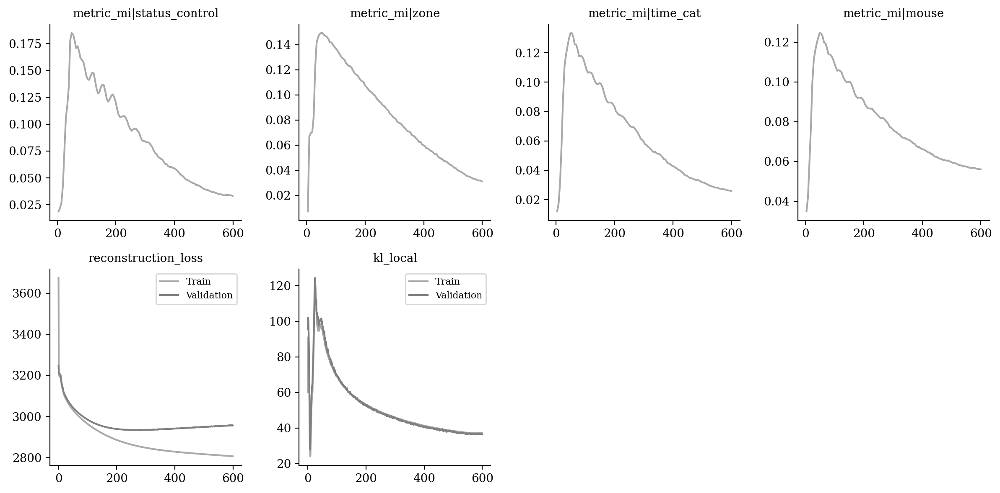

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

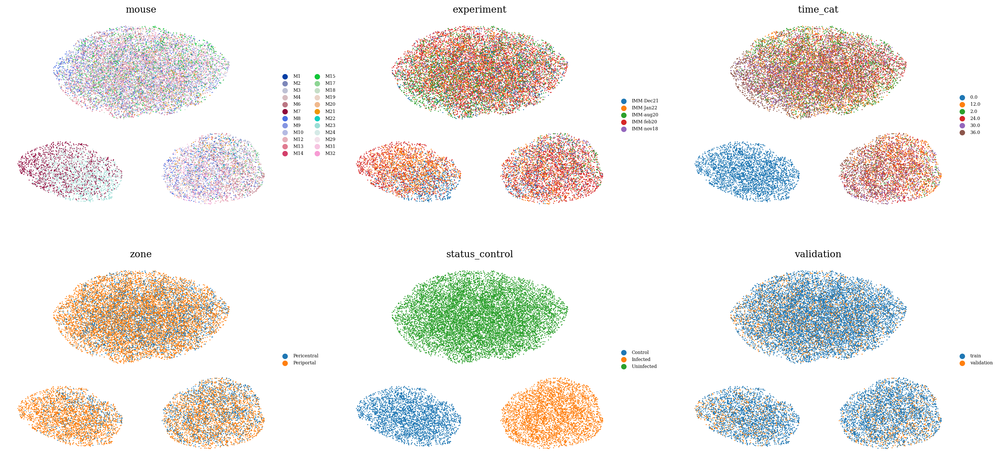

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

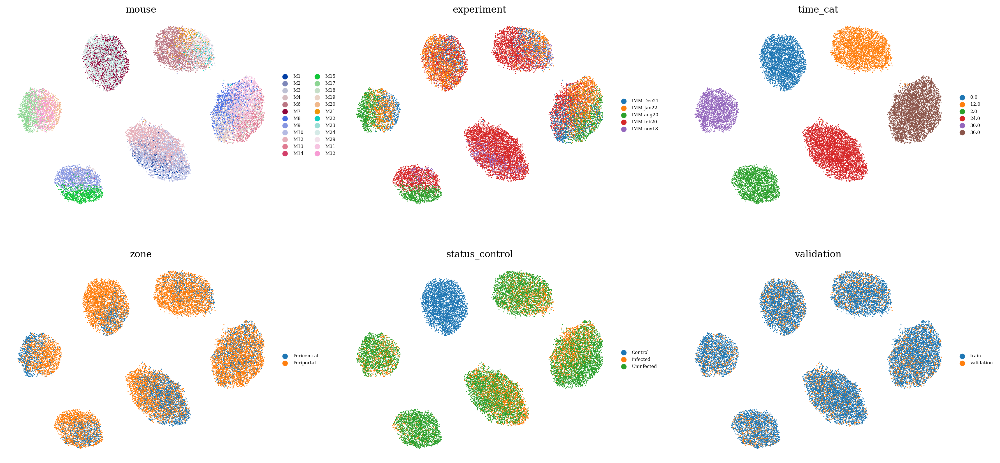

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

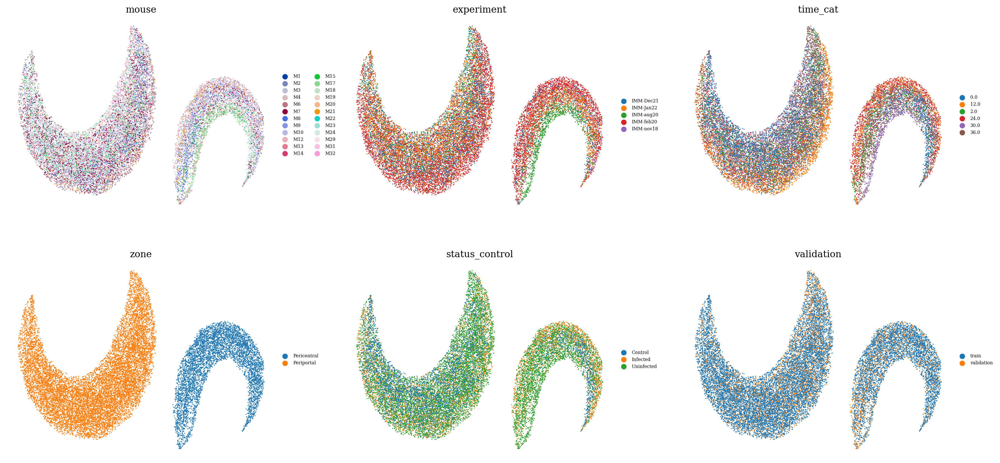

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

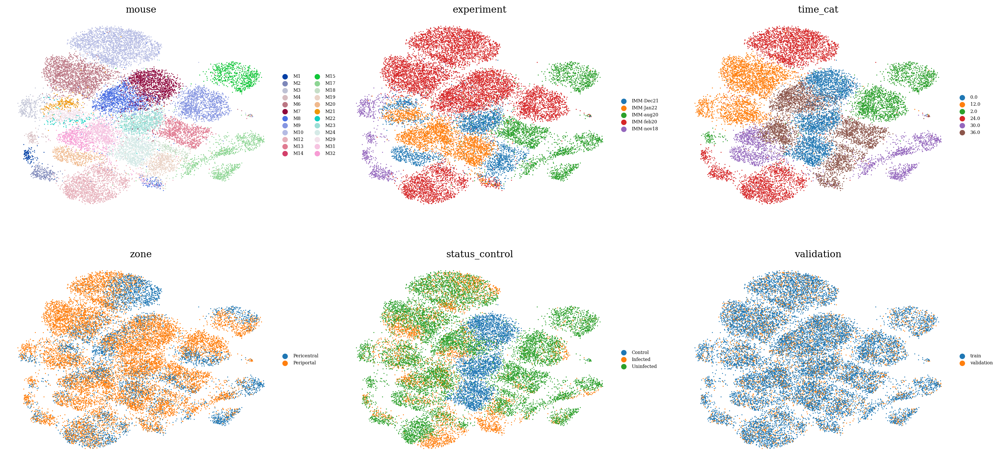

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

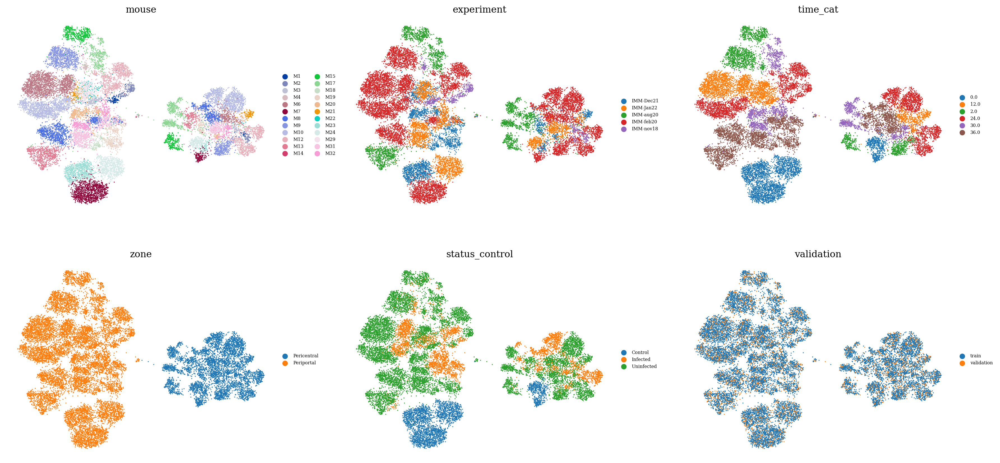

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

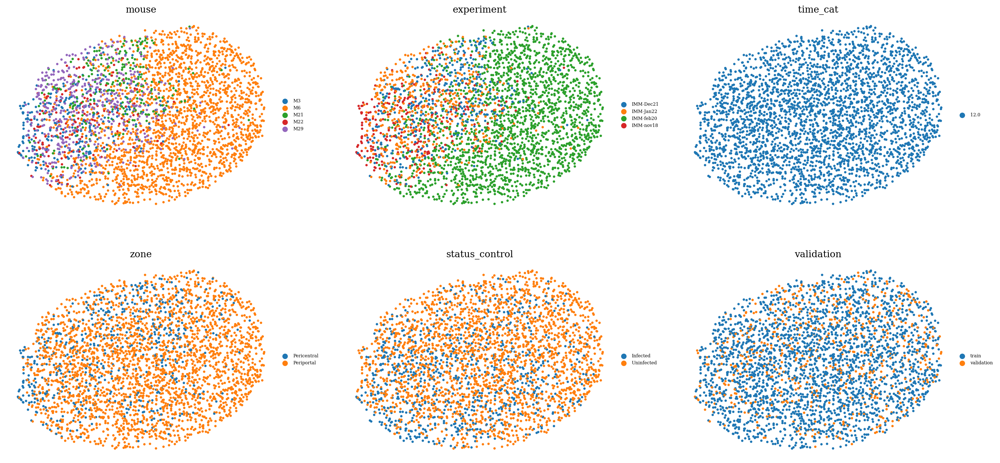

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )